Analysis of the Decam Galactic Bulge Survey (Saha) to create the figures used in DMTN-171
====

## A look at the inputs to the coadds

In [1]:
%matplotlib notebook

import sys
import numpy as np
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from matplotlib.ticker import LogFormatter 
import importlib
import pandas as pd
#import psycopg2

from astropy.coordinates import SkyCoord
import astropy.units as u

import lsst.daf.persistence as dafPersist

In [2]:
import lsst.afw.display as afwDisplay
afwDisplay.setDefaultBackend("matplotlib")

In [3]:
# sys.path.append('/project/mrawls/ap_pipe-notebooks/')
import diaObjectAnalysis as doa
import apdbPlots as pla

In [4]:
repo = '/project/sullivan/saha2/processed_data'

In [5]:
butler = dafPersist.Butler(repo)

In [6]:
ap13_repo = '/project/sullivan/saha2/ap_pipe_slow/cw_2013'
ap15_repo = '/project/sullivan/saha2/ap_pipe_slow/cw_2015'

In [7]:
butler_ap13 = dafPersist.Butler(ap13_repo)
butler_ap15 = dafPersist.Butler(ap15_repo)

In [8]:
full_ccd_list = np.arange(63)

## Define the visits associated with each field/year/band

In [9]:
visits_B1_2013_i = [205419,205490,205532,205705,205736,205768,209472,209534,209582,209784,209826,209880,210108,210112,210163,210216,210269,210305,210506,210553,210595,210631,210667,216042,216043,216044,216045,216046,216058,216070,216082,216094,216106,216118,216130,216142,216988,217027,217037,217047,217057,217067,217077,217087,223463,223499,223536,223572,223795,223831,223867,223903]

In [10]:
visits_B1_2013_g = [205421,205492,205534,205707,205738,205770,209474,209536,209584,209786,209828,209882,210110,210165,210218,210271,210307,210508,210555,210597,210633,210669,223465,223501,223538,223574,223797,223833,223869,223905]

In [11]:
visits_B1_2015_g = [427318,427333,427348,427368,427398,427428,427458,427488,427518,427548,427578,427628,427653,427938,427953,427978,428003,428033,428063,428093,428123,428153,428183,428213,428243,428273,428293,428336,428624,428639,428659,428684,428714,428744,428774,428804,428834,428864,428894,428924,428954,428984,429014,429044]

In [12]:
visits_B1_2015_i = [427316,427331,427346,427366,427396,427426,427456,427486,427516,427546,427576,427616,427651,427936,427951,427976,428001,428031,428061,428091,428121,428151,428181,428211,428241,428271,428291,428334,428622,428637,428657,428682,428712,428742,428772,428802,428832,428862,428892,428922,428952,428982,429012,429042]

In [13]:
visits_B2_2013_g = [205429,205498,205540,205712,205744,205775,209480,209542,209590,209792,209834,209888,209942,210118,210171,210224,210277,210317,210514,210561,210603,210639,210675,223471,223507,223544,223580,223803,223839,223875,223911]

In [14]:
visits_B2_2013_i = [205427,205496,205538,205710,205742,205773,209478,209540,209588,209790,209832,209886,209940,210116,210169,210222,210275,210315,210512,210559,210601,210637,210673,216048,216060,216072,216084,216096,216108,216120,216132,216144,216990,217029,217039,217049,217059,217069,217079,217089,223469,223505,223542,223578,223801,223837,223873,223909]

In [15]:
visits_B2_2015_g = [427323,427338,427353,427373,427403,427433,427463,427493,427523,427553,427583,427626,427658,427943,427958,427983,428008,428038,428068,428098,428128,428158,428188,428218,428248,428278,428298,428341,428629,428644,428664,428689,428719,428749,428779,428809,428839,428869,428899,428929,428959,428989,429019,429049]

In [16]:
visits_B2_2015_i = [427321,427336,427351,427371,427401,427431,427461,427491,427521,427551,427581,427624,427656,427941,427956,427981,428006,428036,428066,428096,428126,428156,428186,428216,428246,428276,428296,428339,428627,428642,428662,428687,428717,428747,428777,428807,428837,428867,428897,428927,428957,428987,429017,429047]

In [17]:
ccd_use = 42
sigma2fwhm = 2.*np.sqrt(2.*np.log(2.))

In [18]:
test = butler.get("src", dataId={"visit":427318, "ccdnum":ccd_use})

In [19]:
s = test[6000]
f_nJy = s['base_PsfFlux_instFlux']
mag = -2.5*np.log10(f_nJy/1e9) + 8.9

In [20]:
mag

24.017523671478575

In [21]:
area = 2000*.26*4000*.26/(3600**2)

In [22]:
len(test)/area

312928.4023668639

In [23]:
visit_lookup = {"2015":{"g":{"B1":visits_B1_2015_g,
                             "B2":visits_B2_2015_g},
                        "i":{"B1":visits_B1_2015_i,
                             "B2":visits_B2_2015_i}
                       },
                "2013":{"g":{"B1":visits_B1_2013_g,
                             "B2":visits_B2_2013_g},
                        "i":{"B1":visits_B1_2013_i,
                             "B2":visits_B2_2013_i}
                       }}

Define the ccds with data

In [24]:
ccd_list = list(np.arange(1,63))
ccd_list.pop(1)
ccd_list.pop(59)

61

## Look at the density of sources across visits for a representative ccd

In [25]:
year = "2015"
band = "g"
field = "B1"

In [26]:
n_src_v = [len(butler.get("src", dataId={"visit":visit, "ccdnum":42})) for visit in visit_lookup[year][band][field]]

In [27]:
max(n_src_v)/area

602539.349112426

In [28]:
src = butler_ap15.get("deepDiff_diaSrc", dataId={"visit":visit_lookup[year][band][field][1], "ccdnum":ccd_use})

In [29]:
src['base_PixelFlags_flag_cr']

array([False, False, False, False, False, False, False, False, False,
       False, False, False,  True, False, False, False, False,  True,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False,  True, False, False,  True, False,
       False, False,  True, False,  True, False, False,  True, False,
        True, False, False, False, False,  True, False, False, False,
        True,  True, False, False, False, False, False, False, False,
       False, False,  True, False,  True, False,  True, False, False,
        True,  True,  True,  True, False, False, False,  True, False,
        True, False, False, False, False, False,  True,  True,  True,
        True, False,  True, False, False, False, False,  True, False,
       False, False, False, False,  True, False,  True, False,  True,
       False,  True,  True, False,  True,  True, False, False,  True,
       False, False,  True, False,  True, False, False, False, False,
       False, False,

In [30]:
badFlagList=['base_PixelFlags_flag_bad',
             'base_PixelFlags_flag_edge',
             'base_PixelFlags_flag_cr',
             'base_PixelFlags_flag_suspect',
             'base_PixelFlags_flag_saturatedCenter']

In [31]:
flag_src = [False]*len(src)
for flag in badFlagList:
    flag_src |= src[flag]

In [32]:
len(src)

953

In [33]:
source_density_lookup = {"2015":{"g":{}, "i":{}}, "2013":{"g":{}, "i":{}}}
for year in ["2015", "2013"]:
    for band in ["g", "i"]:
        for field in ["B1", "B2"]:
            n_src_area = []
            for visit in visit_lookup[year][band][field]:
                src = butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use})
                flag_src = [False]*len(src)
                for flag in badFlagList:
                    flag_src |= src[flag]
                n_src = len(src) - sum(flag_src)
                n_src_area.append(n_src/area)
#             n_src_area = [len(butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use}))/area for visit in visit_lookup[year][band][field]]
            source_density_lookup[year][band][field] = n_src_area

In [34]:
diaSource_density_lookup = {"2015":{"g":{}, "i":{}}, "2013":{"g":{}, "i":{}}}
for year in ["2015", "2013"]:
    if year == "2015":
        butler_use = butler_ap15
    else:
        butler_use = butler_ap13
    for band in ["g", "i"]:
        for field in ["B1", "B2"]:
            n_src_area = []
            for visit in visit_lookup[year][band][field]:
                try:
                    src = butler_use.get("deepDiff_diaSrc", dataId={"visit":visit, "ccdnum":ccd_use})
                except Exception:
                    continue
                flag_src = [False]*len(src)
                for flag in badFlagList:
                    flag_src |= src[flag]
                n_src = len(src) - sum(flag_src)
                n_src_area.append(n_src/area)
#             n_src_area = [len(butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use}))/area for visit in visit_lookup[year][band][field]]
            diaSource_density_lookup[year][band][field] = n_src_area

In [35]:
def source_density_histogram(band, field, source_density_lookup, filename=None, bins=12):
    colors = {"2015":'b', "2013":'r'}
    fig, ax = plt.subplots(figsize=(6, 4))
    legend = []
    for year in ["2015", "2013"]:
        plt.hist(source_density_lookup[year][band][field], bins, alpha=0.5, color=colors[year])
        legend.append(f"{year} {band}-band field {field}")
            # plt.hist(psf_size_B1_2015_g_dict.values(), 20, alpha=0.5, color='r')
    plt.xlabel('Number of measured sources per square degree')
    plt.ylabel('Visit count')
    # secax = ax.secondary_xaxis('top', functions=(lambda x: x*pixelScale, lambda x: x/pixelScale))
    # secax.set_xlabel('Seeing FWHM (arcseconds)')
    # plt.axvline(x=4.2, color='k', linestyle="--")
    plt.legend(legend)
    
    if filename:
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")

In [36]:
hist_bins=np.arange(1e5,7e5,5e4)

In [37]:
hist_bins

array([100000., 150000., 200000., 250000., 300000., 350000., 400000.,
       450000., 500000., 550000., 600000., 650000.])

<IPython.core.display.Javascript object>


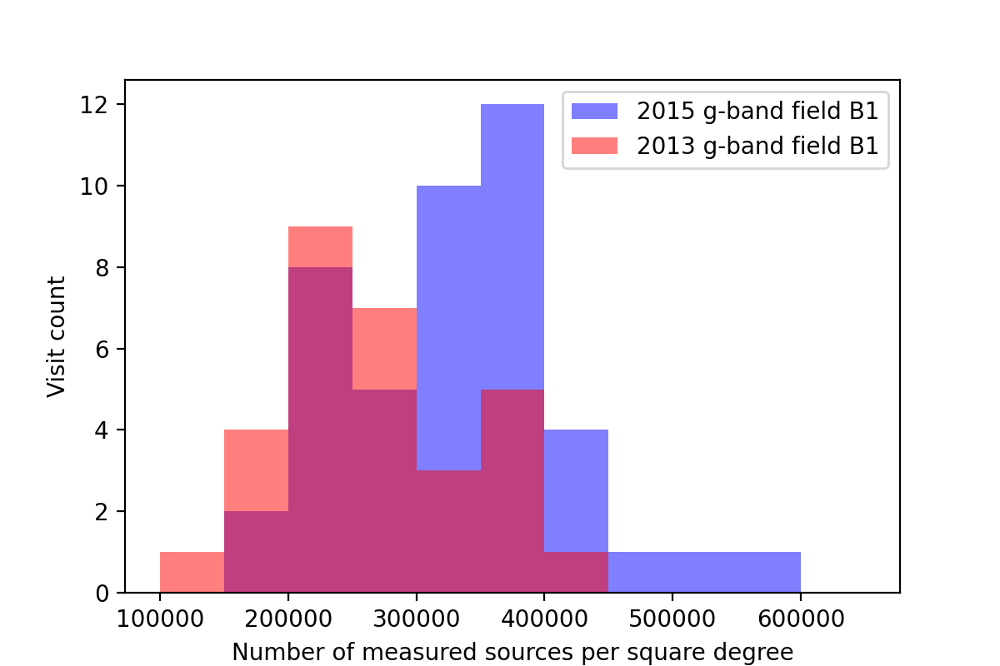

<IPython.core.display.Javascript object>


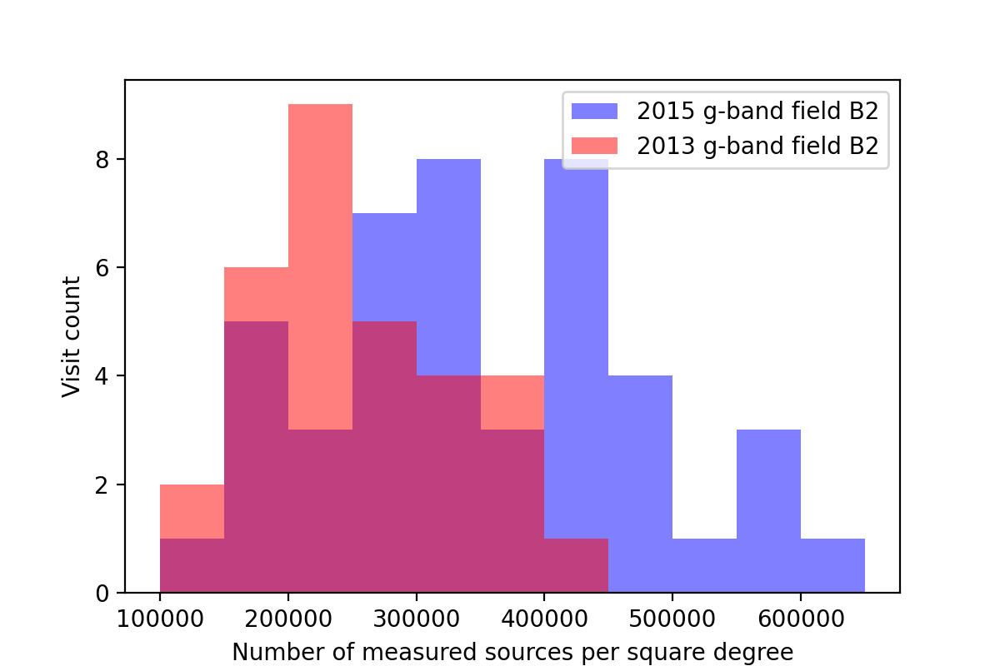

<IPython.core.display.Javascript object>


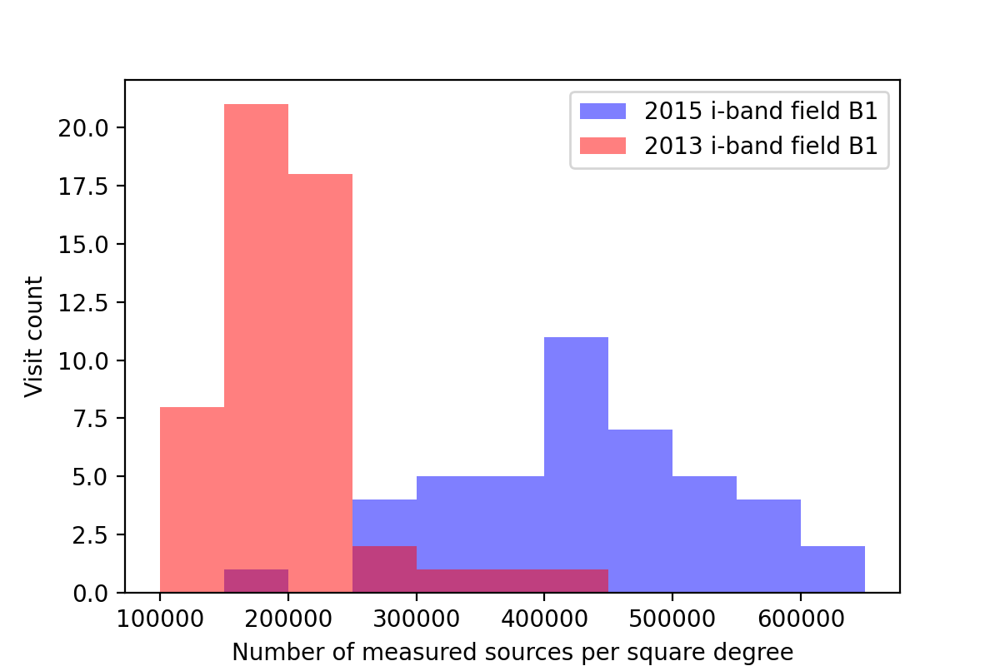

<IPython.core.display.Javascript object>


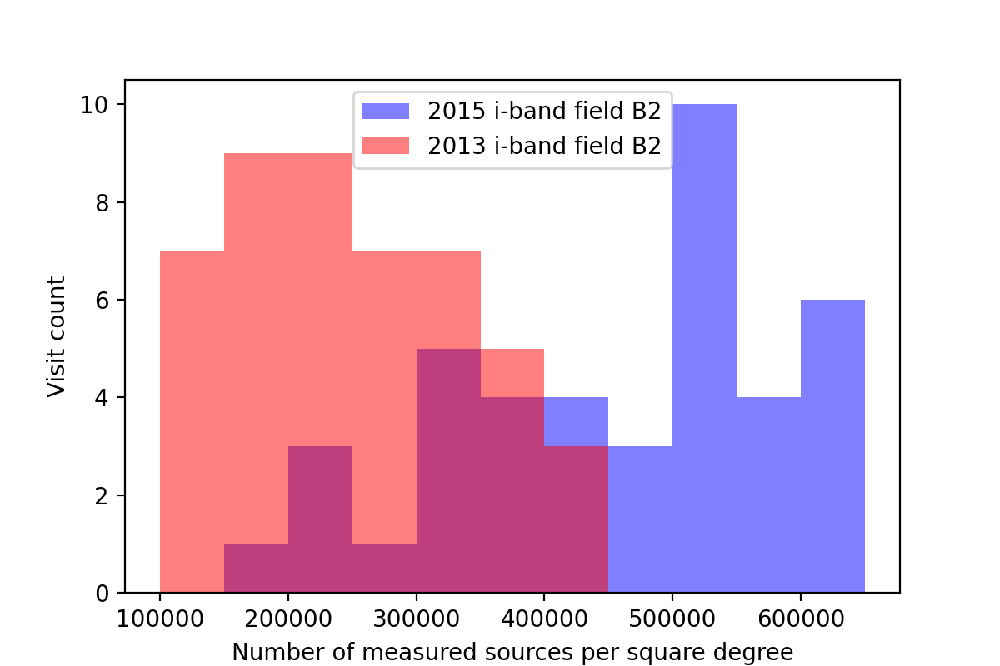

In [38]:
for band in ["g", "i"]:
    for field in ["B1", "B2"]:
        source_density_histogram(band, field, source_density_lookup, bins=hist_bins, filename=f"Source_density_{field}_{band}_ccd42.png")

In [39]:
diff_bins = np.arange(0,120000, 1000)

In [40]:
diaSource_density_lookup

{'2015': {'g': {'B1': [10136.98224852071,
    6566.2721893491125,
    7405.029585798817,
    4385.502958579882,
    9322.189349112426,
    7764.497041420118,
    5272.1893491124265,
    6230.7692307692305,
    14186.98224852071,
    8291.715976331361,
    8459.467455621301,
    7596.745562130178,
    9801.479289940828,
    7428.994082840237,
    5967.15976331361,
    7165.384615384615,
    6997.633136094674,
    5967.15976331361,
    7740.532544378699,
    5943.19526627219,
    3211.242603550296,
    6853.846153846154,
    6686.094674556213,
    6901.775147928995,
    6781.952662721894,
    5655.621301775148,
    3978.1065088757396,
    4337.573964497042,
    4577.218934911242,
    4121.89349112426],
   'B2': [7476.923076923077,
    7860.355029585799,
    8028.10650887574,
    8723.076923076924,
    8195.85798816568,
    5631.656804733728,
    30123.37278106509,
    5799.408284023669,
    13492.011834319526,
    15097.633136094675,
    5871.301775147929,
    10544.378698224853,
    103

<IPython.core.display.Javascript object>


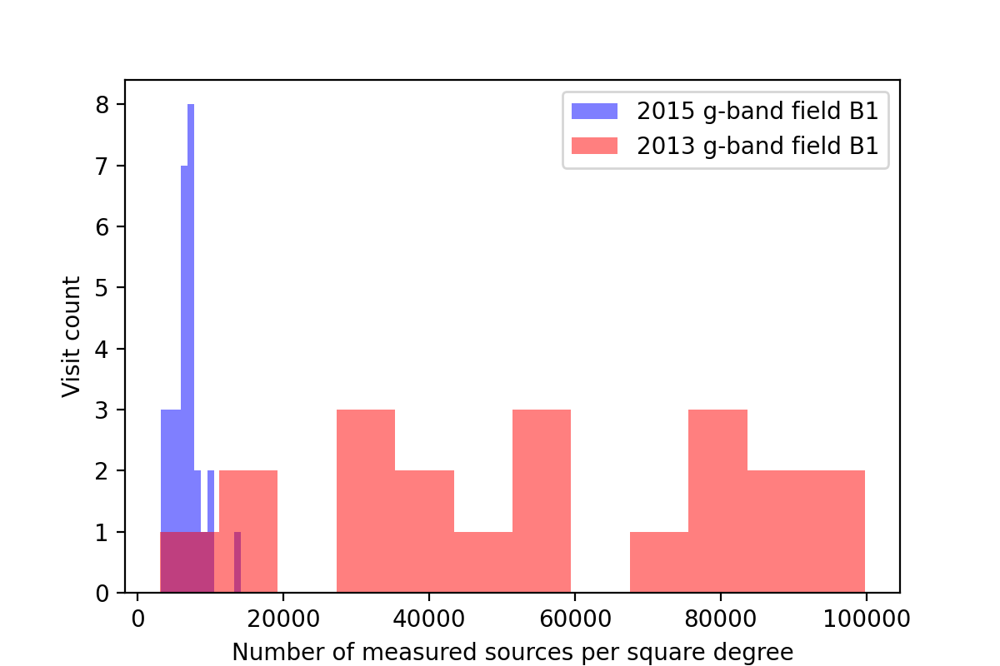

<IPython.core.display.Javascript object>


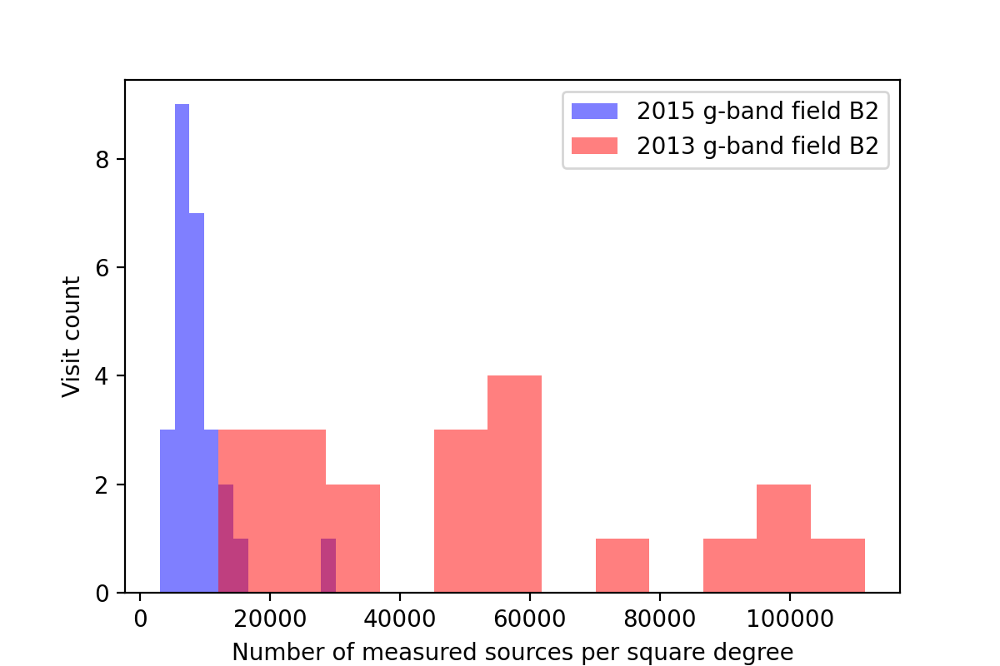

<IPython.core.display.Javascript object>


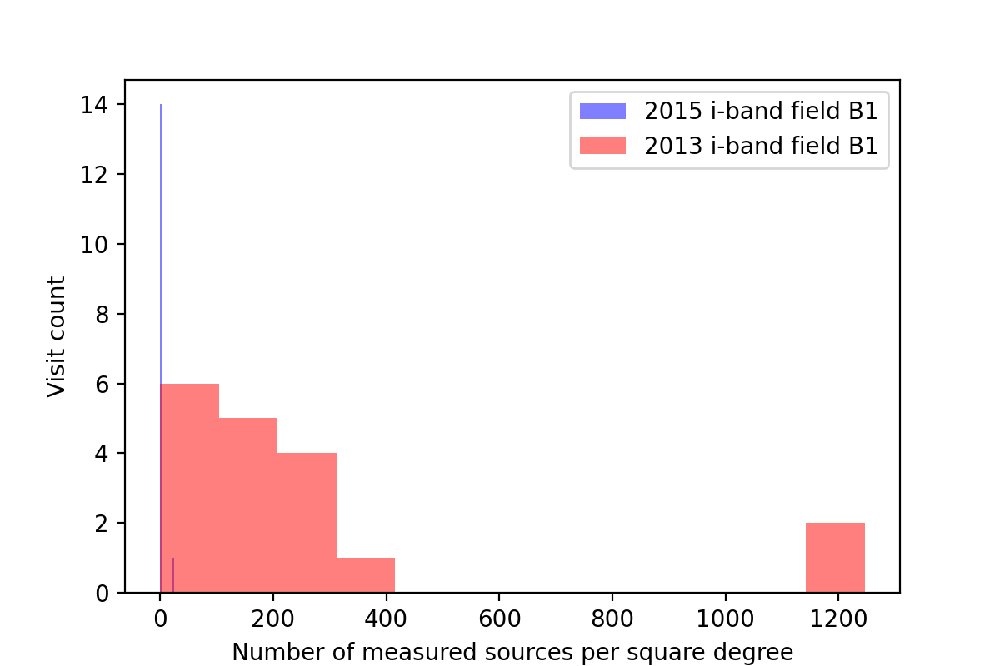

<IPython.core.display.Javascript object>


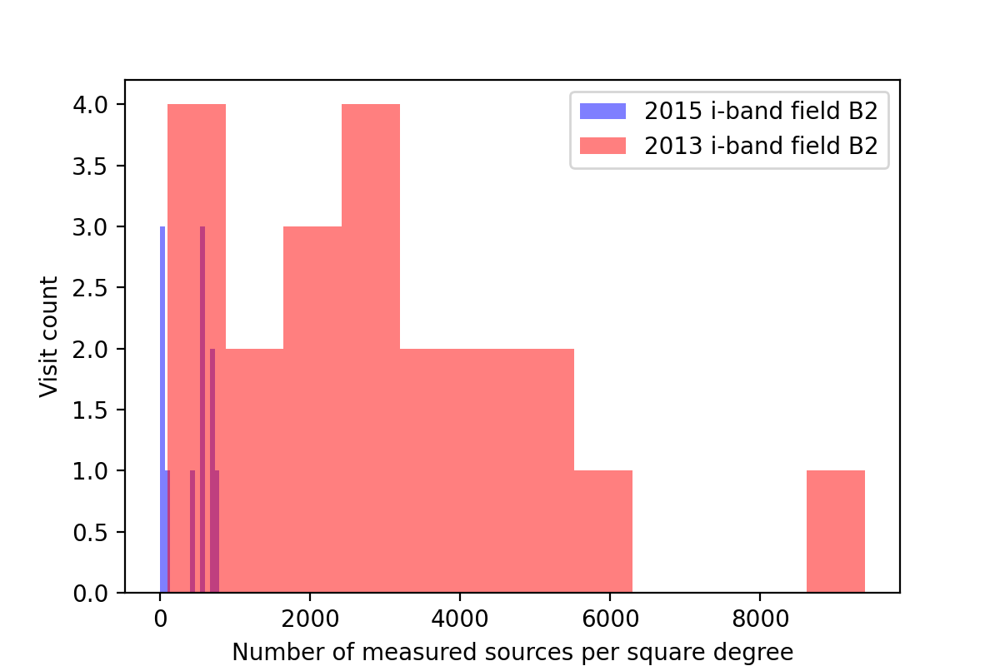

In [41]:
for band in ["g", "i"]:
    for field in ["B1", "B2"]:
        source_density_histogram(band, field, diaSource_density_lookup, bins=12)

<IPython.core.display.Javascript object>


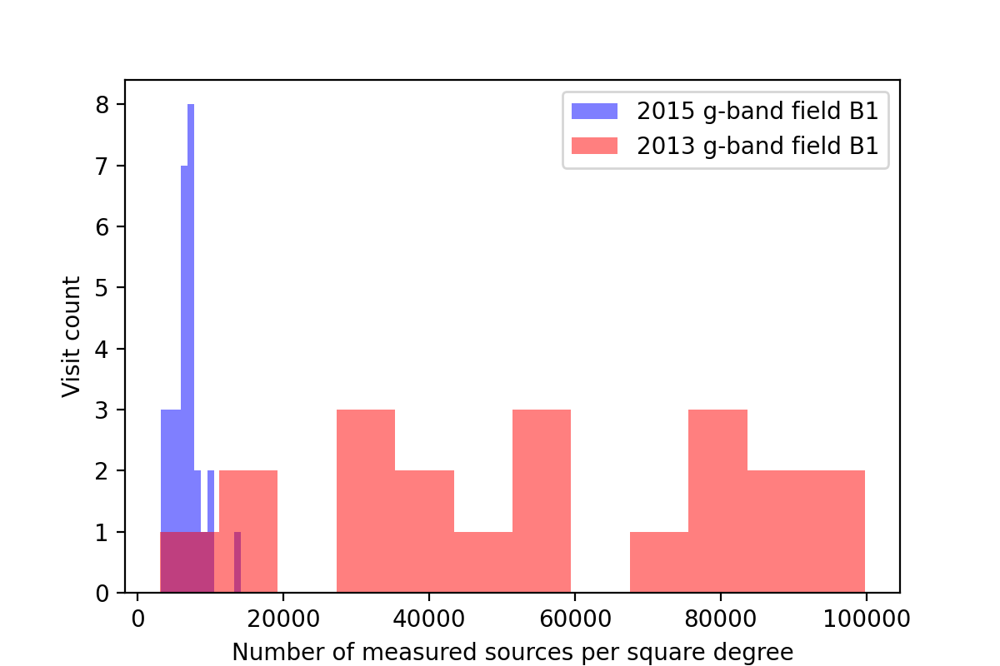

<IPython.core.display.Javascript object>


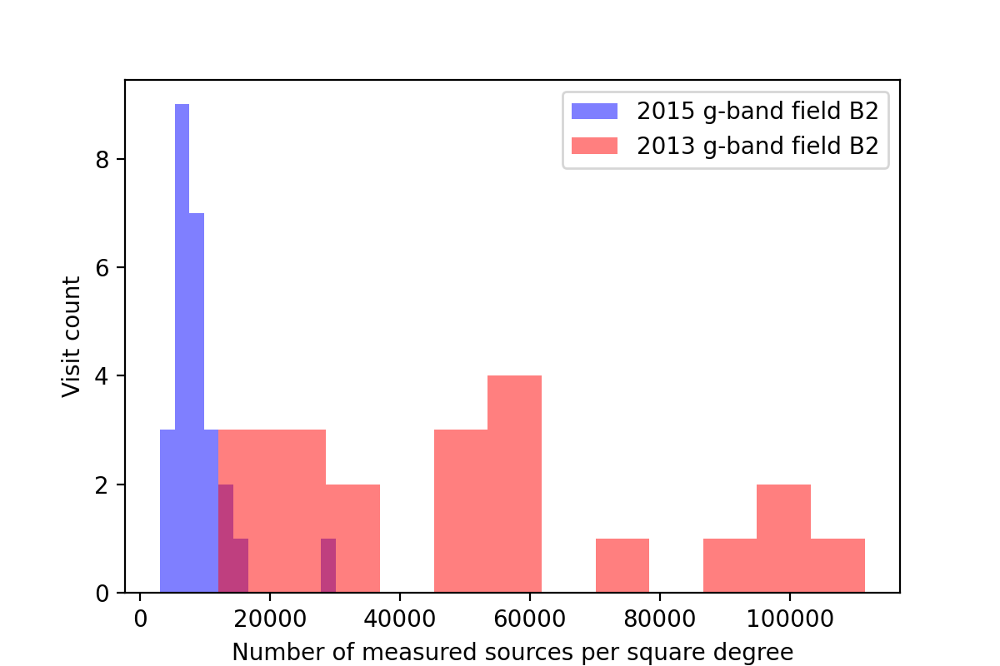

<IPython.core.display.Javascript object>


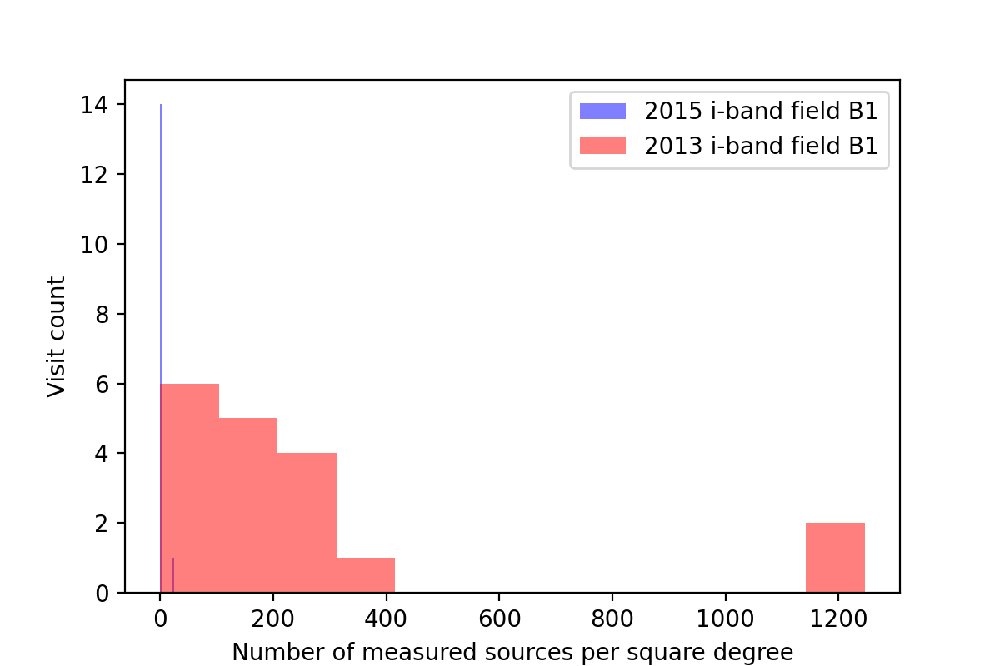

<IPython.core.display.Javascript object>


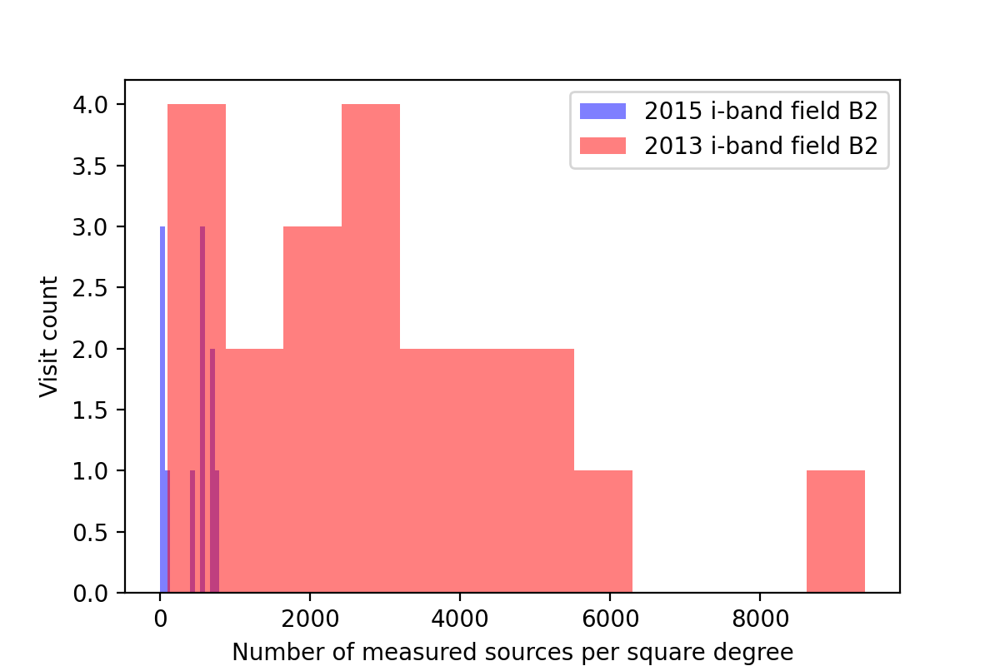

In [42]:
for band in ["g", "i"]:
    for field in ["B1", "B2"]:
        source_density_histogram(band, field, diaSource_density_lookup, filename=f"DiaSource_density_{field}_{band}_ccd42.png")

Look at the distribution of detected source magnitudes 

In [43]:
def convert_nJy_ABmag(f_nJy):
    mag = -2.5*np.log10(f_nJy/1e9) + 8.9
    return mag

In [44]:
src = butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use})
flag_src = [False]*len(src)
f_nJy = src['base_PsfFlux_instFlux']
for flag in badFlagList:
    flag_src |= src[flag]
good_fluxes = np.array([s for s, f in zip(f_nJy, flag_src) if ~f and s > 0])

mags = convert_nJy_ABmag(good_fluxes)
hist, bin_edges = np.histogram(mags)
bin_centers = [(bin_edges[i] + bin_edges[i + 1])/2 for i in range(len(bin_edges) - 1)]

In [45]:
hist/area/.2

array([145224.85207101, 195789.9408284 , 228381.65680473, 234732.24852071,
         7069.52662722,   2036.98224852,   1557.69230769,   1318.04733728,
          239.64497041,    479.28994083])

In [46]:
def inspect_source_counts(year, band, field, visit_lookup, ccd_use=42, binsize=0.2, min_magnitude=17, max_magnitude=20, select_bin=None, filename=None):
    area = 2000*.26*4000*.26/(3600**2)
    fig, ax = plt.subplots(figsize=(6, 4))
    if select_bin is None:
        select_bin = 18.0 if band=='i' else 19.5
    densities = []
    for visit in visit_lookup[year][band][field]:
        src = butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use})
        flag_src = [False]*len(src)
        f_nJy = src['base_PsfFlux_instFlux']
        for flag in badFlagList:
            flag_src |= src[flag]
        good_fluxes = np.array([s for s, f in zip(f_nJy, flag_src) if ~f and s > 0])

        mags = convert_nJy_ABmag(good_fluxes)
        if min_magnitude is None:
            min_magnitude = np.floor(np.min(mags)/binsize)*binsize
        if max_magnitude is None:
            max_magnitude = np.ceil(np.max(mags)/binsize)*binsize

        nbins = int((max_magnitude - min_magnitude)/binsize)
        hist, bin_edges = np.histogram(mags, bins=nbins, range=(min_magnitude, max_magnitude))
        bin_centers = [(bin_edges[i] + bin_edges[i + 1])/2 for i in range(len(bin_edges) - 1)]
        bin_use = np.argmax(bin_edges[bin_edges <= select_bin])
#         bin_high = np.argmin(bin_edges[bin_edges >= select_bin])
        source_density = hist[bin_use]/area/binsize
        densities.append(source_density)
    plt.plot(visit_lookup[year][band][field], densities, "b+", linestyle='')
    plt.title(f"{year} {band}-band field {field} source counts at {select_bin} magnitude")
    plt.xlabel('Visit')
    plt.ylabel('Detected sources / magnitude / degree^2')
    bad_visits = []
    for i, visit in enumerate(visit_lookup[year][band][field]):
        d = densities[i]
        if abs(d - np.median(densities)) > np.std(densities):
            ax.annotate(visit, (visit, densities[i]))
            bad_visits.append(visit)
    print(f"Miscalibrated visits: {repr(bad_visits)}")
    ax.set_yscale('log')
    
    if filename:
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")

<IPython.core.display.Javascript object>


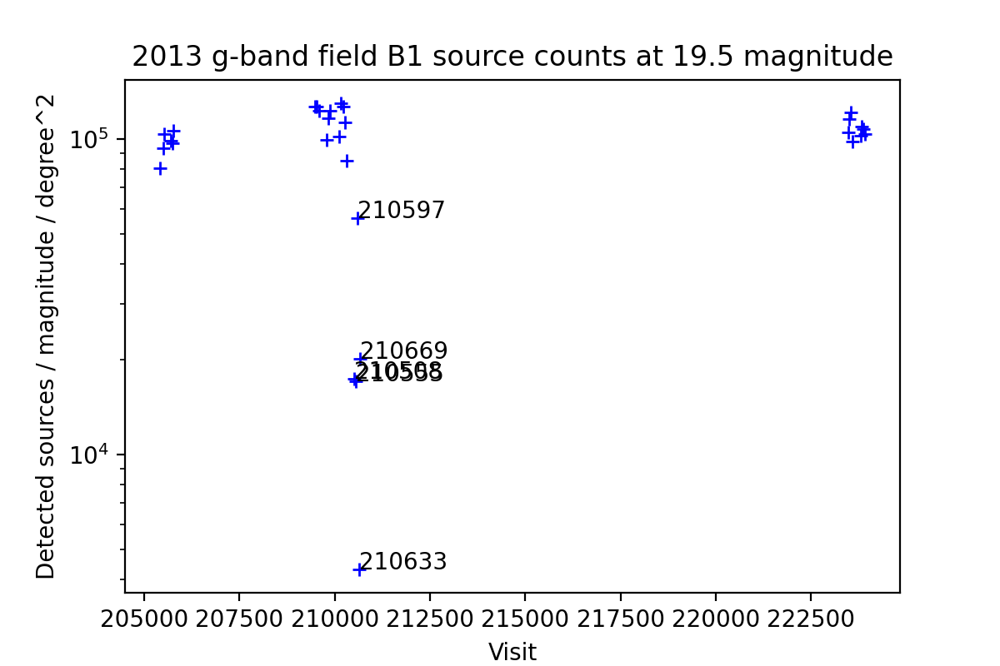

Miscalibrated visits: [210508, 210555, 210597, 210633, 210669]


In [47]:
inspect_source_counts('2013', 'g', 'B1', visit_lookup)

<IPython.core.display.Javascript object>


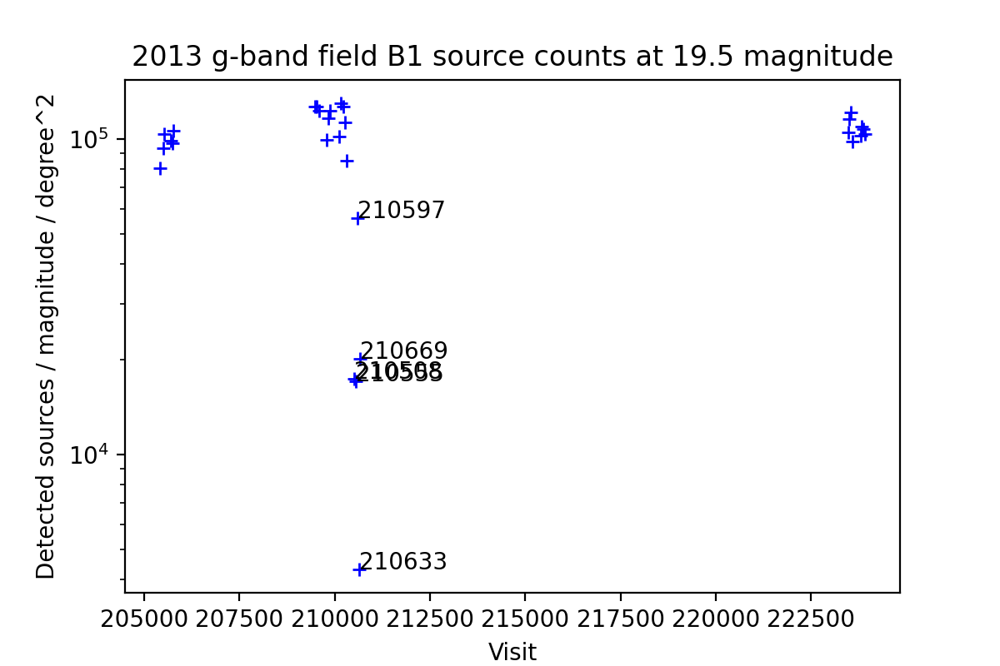

Miscalibrated visits: [210508, 210555, 210597, 210633, 210669]


<IPython.core.display.Javascript object>


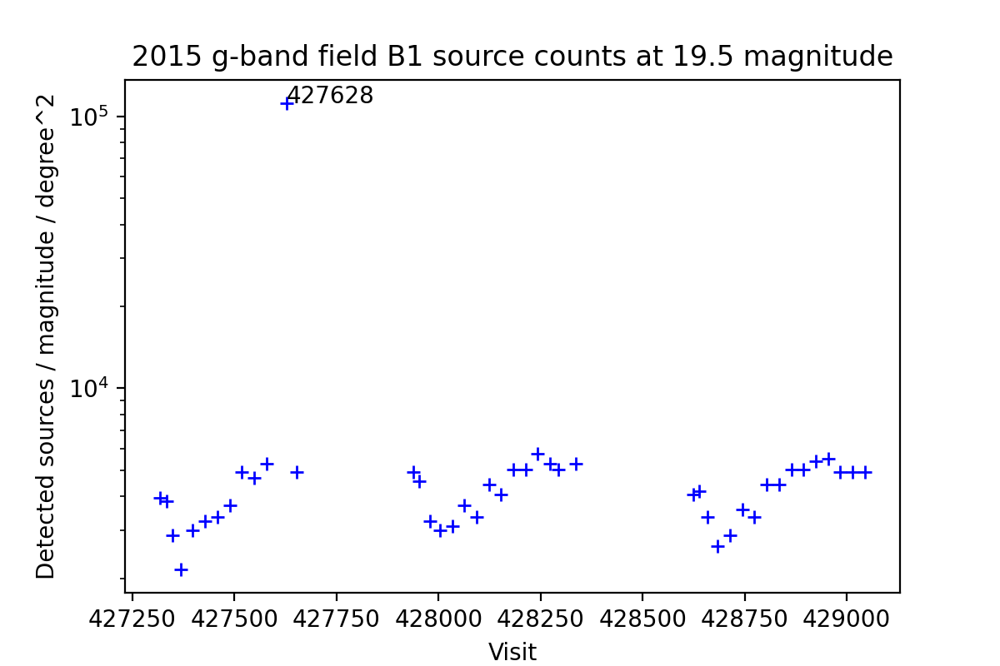

Miscalibrated visits: [427628]


<IPython.core.display.Javascript object>


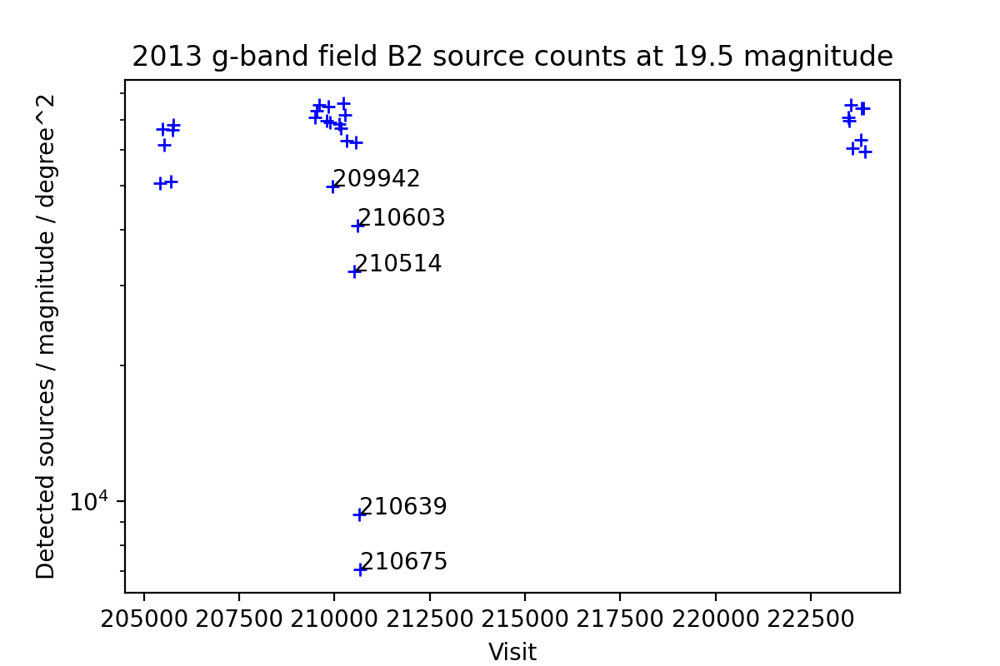

Miscalibrated visits: [209942, 210514, 210603, 210639, 210675]


<IPython.core.display.Javascript object>


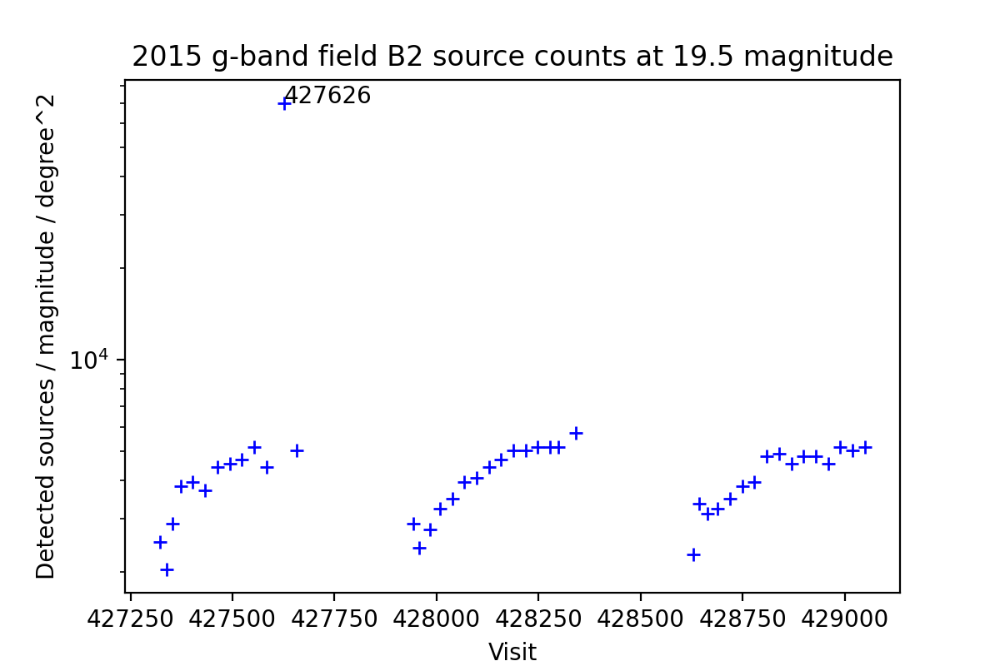

Miscalibrated visits: [427626]


<IPython.core.display.Javascript object>


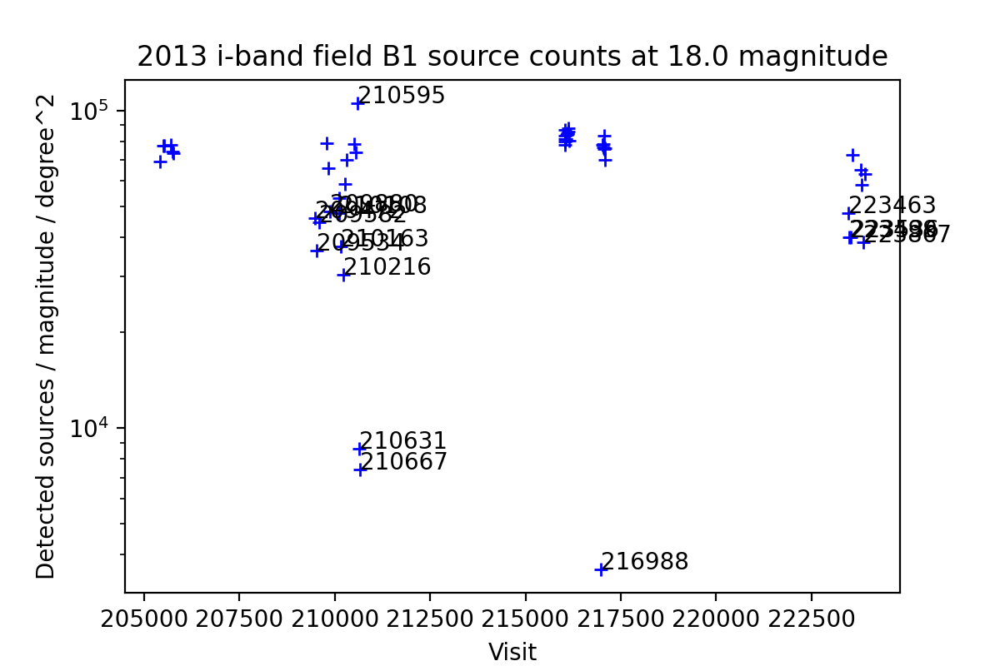

Miscalibrated visits: [209472, 209534, 209582, 209880, 210108, 210163, 210216, 210595, 210631, 210667, 216988, 223463, 223499, 223536, 223867]


<IPython.core.display.Javascript object>


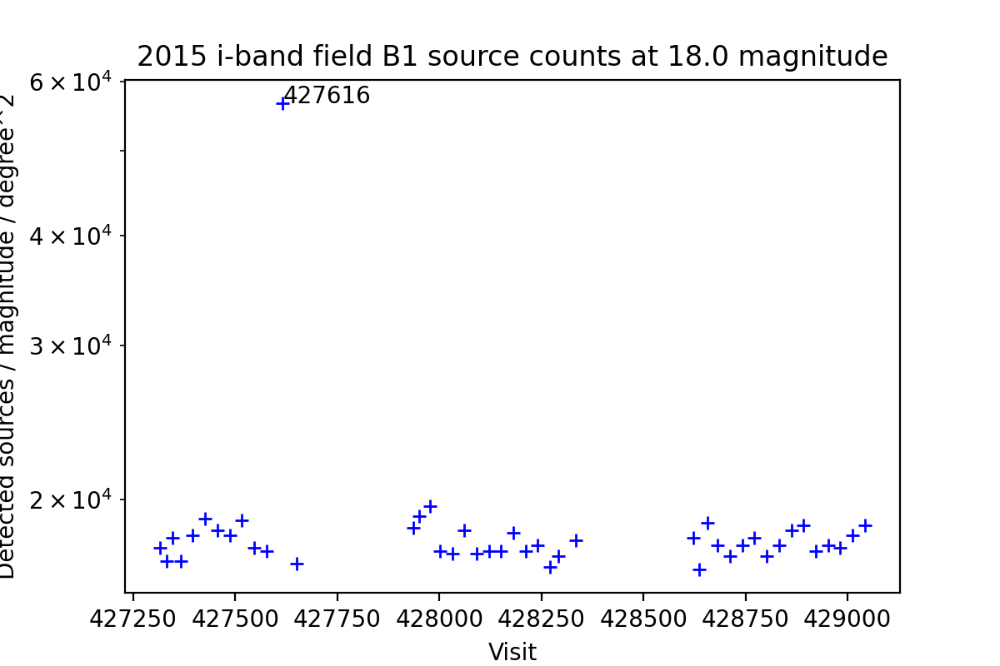

Miscalibrated visits: [427616]


<IPython.core.display.Javascript object>


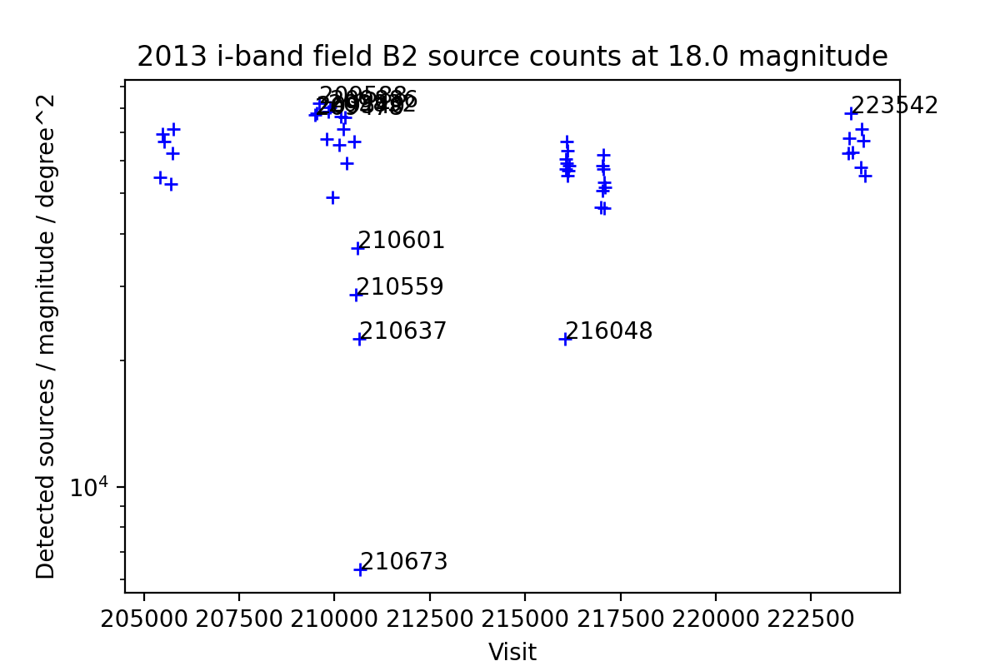

Miscalibrated visits: [209478, 209540, 209588, 209832, 209886, 210559, 210601, 210637, 210673, 216048, 223542]


<ipython-input-46-7641ddbd820b>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(6, 4))


<IPython.core.display.Javascript object>


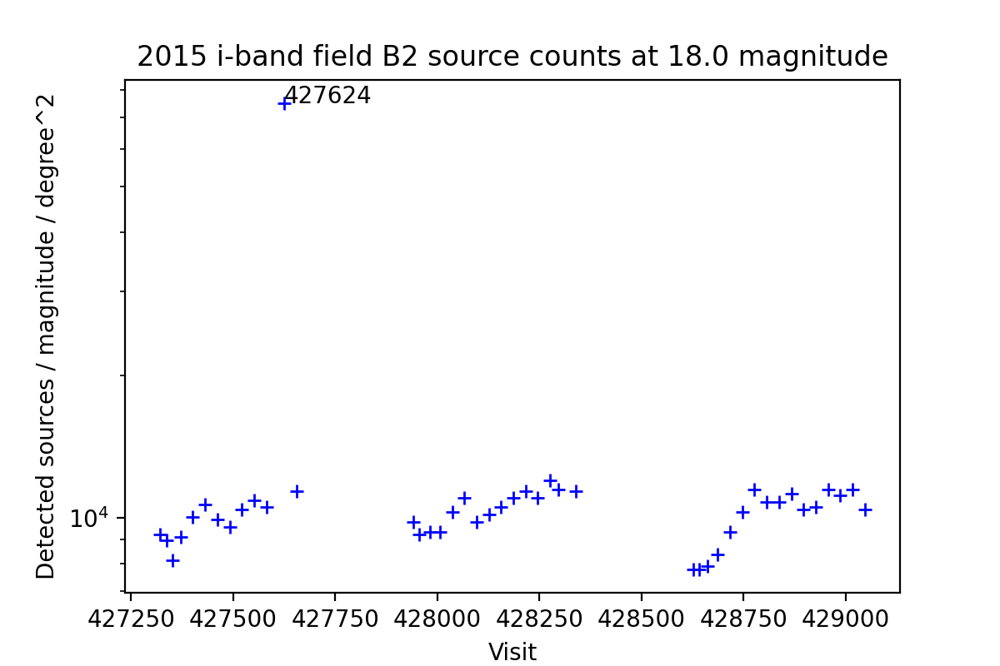

Miscalibrated visits: [427624]


In [48]:
for band in ["g", "i"]:
    for field in ["B1", "B2"]:
        for year in ["2013", "2015"]:
            inspect_source_counts(year, band, field, visit_lookup, filename=f"Source_counts_inspect_{year}_{field}_{band}_ccd42.png")

In [49]:
bad_visits = {"2015":{"g":{"B1":[427628],
                           "B2":[427626]},
                      "i":{"B1":[427616],
                           "B2":[427624]}
                     },
              "2013":{"g":{"B1":[210508,210555,210597,210633,210669],
                           "B2":[209942, 210514, 210603, 210639, 210675]},
                      "i":{"B1":[210631, 210667, 216988],
                           "B2":[210559, 210601, 210637, 210673, 216048]}
                     }}

In [50]:
for year in ["2015", "2013"]:
    for band in ["g", "i"]:
        for field in ["B1", "B2"]:
            seeing_list = []
            print(f"Processing {year} {band} {field}: {bad_visits[year][band][field]}")
            for visit in bad_visits[year][band][field]:
                psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
                fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
                seeing_list.append(fwhm)
            print(f"Seeing: {repr(seeing_list)}")

Processing 2015 g B1: [427628]
Seeing: [3.8377057172100937]
Processing 2015 g B2: [427626]
Seeing: [4.046653831426419]
Processing 2015 i B1: [427616]
Seeing: [3.668268855845133]
Processing 2015 i B2: [427624]
Seeing: [3.185367178001274]
Processing 2013 g B1: [210508, 210555, 210597, 210633, 210669]
Seeing: [5.9382248873383014, 4.348650729833699, 3.648524921814897, 4.129801627241028, 5.153923681217653]
Processing 2013 g B2: [209942, 210514, 210603, 210639, 210675]
Seeing: [6.902175689502052, 5.677273872015376, 4.106024227484092, 4.61970037889557, 5.855358272732459]
Processing 2013 i B1: [210631, 210667, 216988]
Seeing: [3.7647810440852876, 4.571221412573046, 7.562269789534826]
Processing 2013 i B2: [210559, 210601, 210637, 210673, 216048]
Seeing: [4.17006355250532, 4.366223223654629, 4.143107790162596, 4.346221426803933, 8.119273800044136]


In [51]:
def source_magnitude_histogram(year, band, field, visit_lookup, ccd_use=42, filename=None, binsize=0.2, min_magnitude=None, max_magnitude=None):
    colors = {"2015":'b', "2013":'r'}
    area = 2000*.26*4000*.26/(3600**2)
    fig, ax = plt.subplots(figsize=(6, 4))
#     fig = plt.figure()
#     ax = plt.subplot(111)
#     legend = []
    for visit in visit_lookup[year][band][field]:
#     visit = visit_lookup[year][band][field][visit_id]
        src = butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use})
        flag_src = [False]*len(src)
        f_nJy = src['base_PsfFlux_instFlux']
        for flag in badFlagList:
            flag_src |= src[flag]
        good_fluxes = np.array([s for s, f in zip(f_nJy, flag_src) if ~f and s > 0])

        mags = convert_nJy_ABmag(good_fluxes)
        if min_magnitude is None:
            min_magnitude = np.floor(np.min(mags)/binsize)*binsize
        if max_magnitude is None:
            max_magnitude = np.ceil(np.max(mags)/binsize)*binsize

        nbins = int((max_magnitude - min_magnitude)/binsize)
        hist, bin_edges = np.histogram(mags, bins=nbins, range=(min_magnitude, max_magnitude))
        bin_centers = [(bin_edges[i] + bin_edges[i + 1])/2 for i in range(len(bin_edges) - 1)]
    #     plt.hist(mags, bins, alpha=0.5, color=colors[year])
        plt.plot(bin_centers, hist/area/binsize, label=visit)
        # plt.hist(psf_size_B1_2015_g_dict.values(), 20, alpha=0.5, color='r')
#         legend.append(visit)
    plt.title(f"{year} {band}-band field {field} source counts")
    plt.xlabel('Magnitude')
    plt.ylabel('Detected sources / magnitude / degree^2')
    ax.set_yscale('log')
    # secax = ax.secondary_xaxis('top', functions=(lambda x: x*pixelScale, lambda x: x/pixelScale))
    # secax.set_xlabel('Seeing FWHM (arcseconds)')
    # plt.axvline(x=4.2, color='k', linestyle="--")
#     plt.legend(legend, ncol=3, bbox_to_anchor=(.95, 1), loc='upper left', fontsize='xx-small')
#     box = ax.get_position()
#     ax.set_position([box.x0, box.y0 + box.height * 0.1,
#                      box.width, box.height * 0.9])

#     # Put a legend below current axis
#     ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
#               fancybox=True, shadow=True, ncol=6, fontsize='xx-small')
    if filename:
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")

<IPython.core.display.Javascript object>


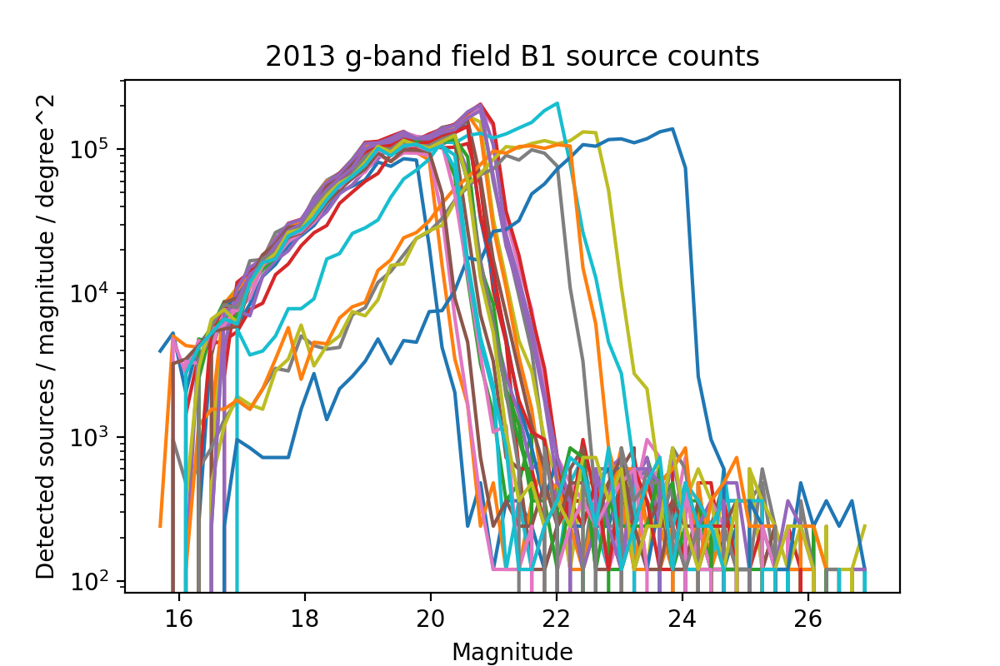

<IPython.core.display.Javascript object>


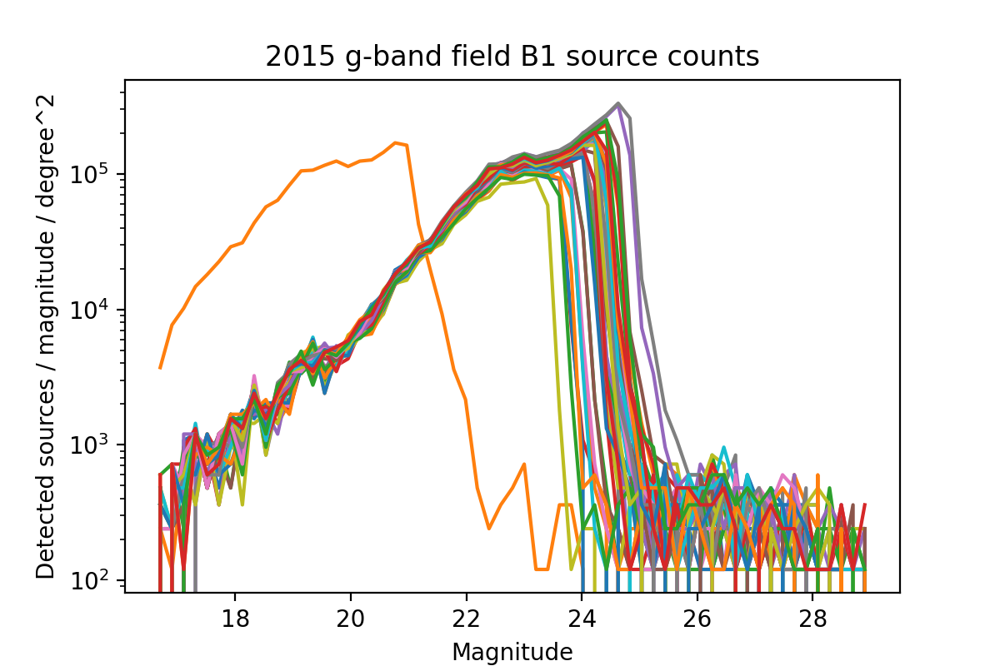

<IPython.core.display.Javascript object>


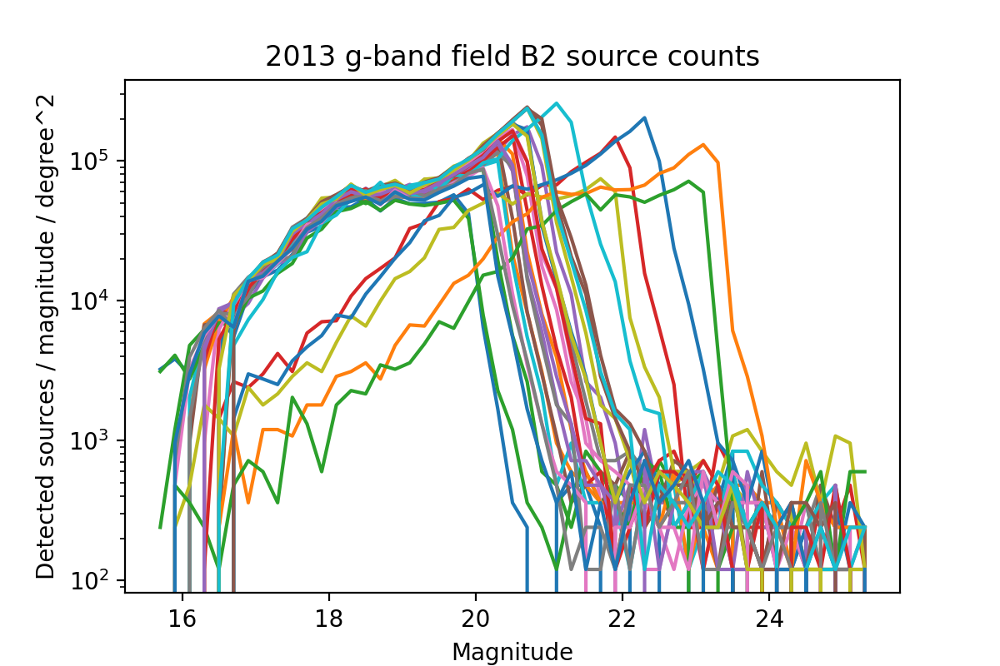

<IPython.core.display.Javascript object>


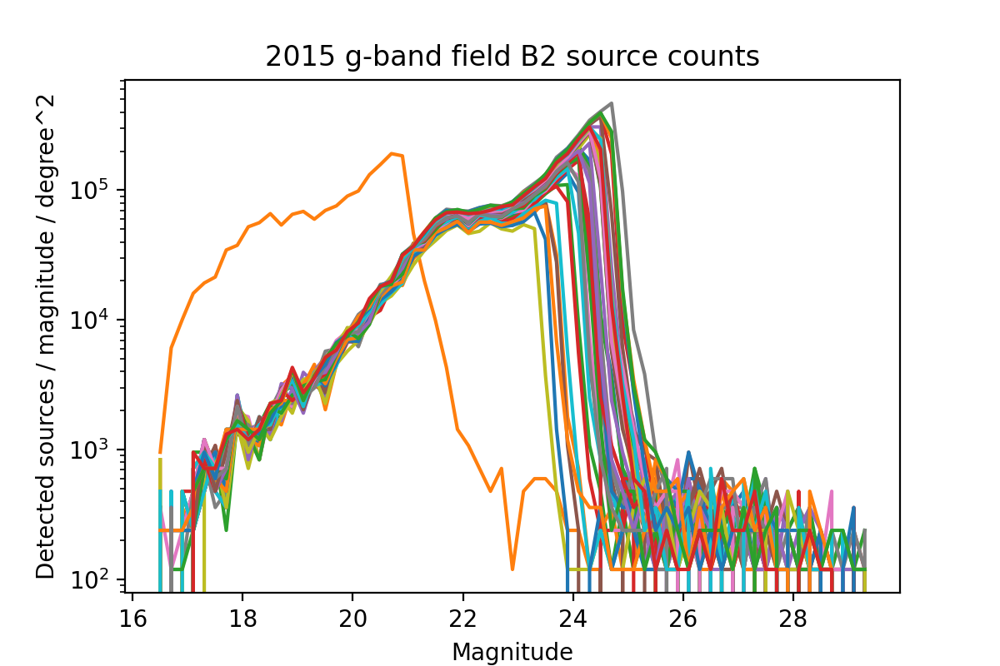

<IPython.core.display.Javascript object>


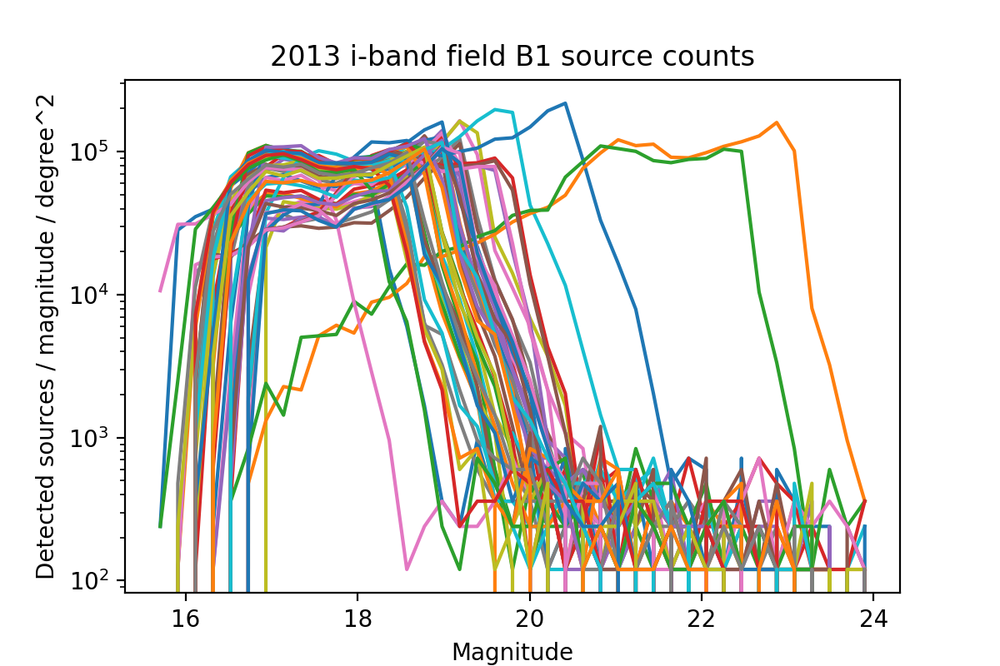

<IPython.core.display.Javascript object>


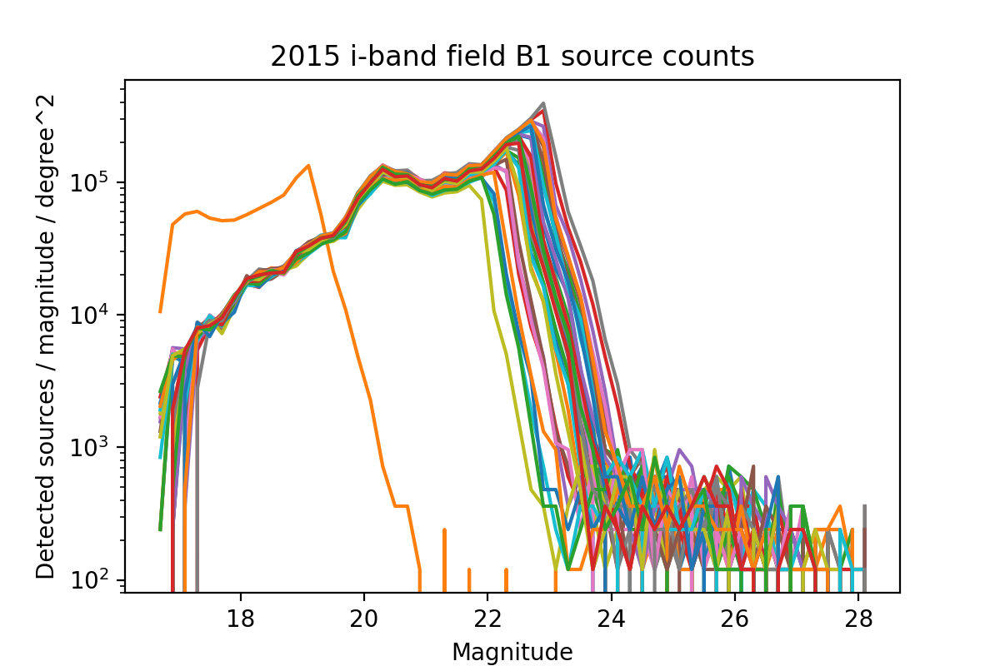

<IPython.core.display.Javascript object>


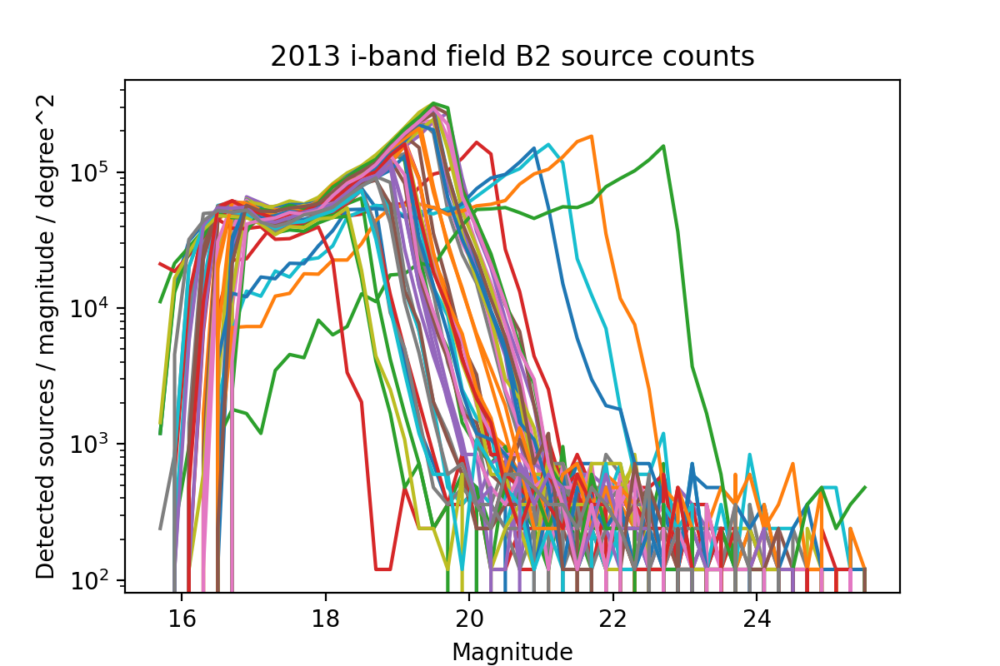

<IPython.core.display.Javascript object>


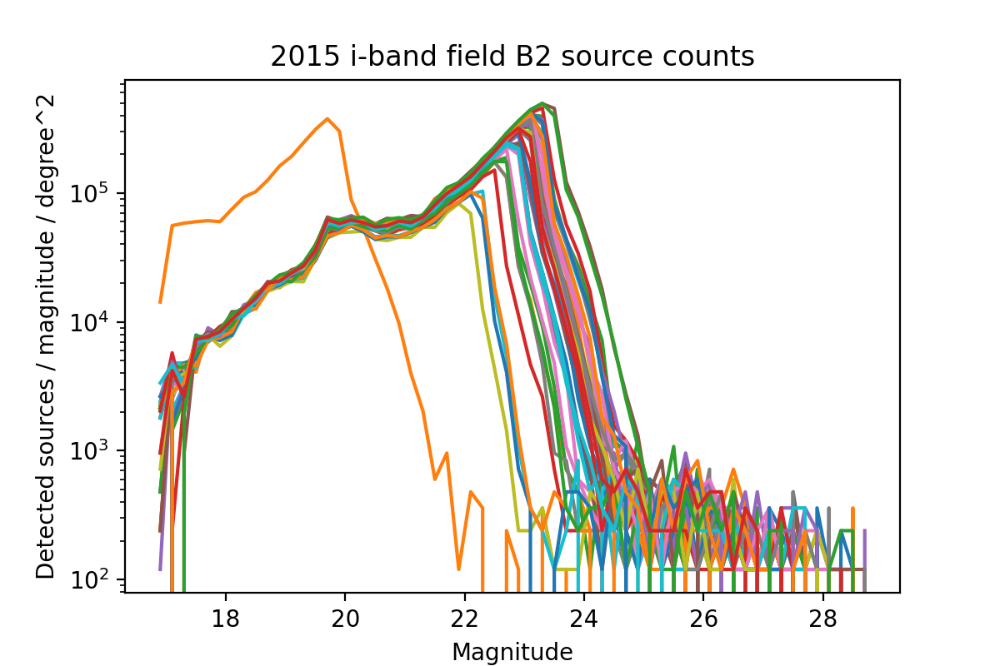

In [105]:
for band in ["g", "i"]:
    for field in ["B1", "B2"]:
        for year in ["2013", "2015"]:
            source_magnitude_histogram(year, band, field, visit_lookup, filename=f"Source_counts_{year}_{field}_{band}_ccd42.png")

In [106]:
visits_B1_2015_g[0]

427318

In [54]:
visit = visit_lookup['2015']['g']['B1'][0]
src = butler.get("src", dataId={"visit":visit, "ccdnum":ccd_use})
flag_src = [False]*len(src)
for flag in badFlagList:
    flag_src |= src[flag]

In [55]:
len(src)

13058

In [56]:
src = [s for s, f in zip(src, flag_src) if ~f]

In [57]:
len(src)

12436

In [58]:
s = test
f_nJy = s['base_PsfFlux_instFlux']
mag = -2.5*np.log10(f_nJy/1e9) + 8.9

<ipython-input-58-3f128dc2f0e7>:3: RuntimeWarning: invalid value encountered in log10
  mag = -2.5*np.log10(f_nJy/1e9) + 8.9


In [59]:
mag

array([21.82044039, 21.99342353, 23.72840997, ..., 24.22569751,
       21.92019484, 22.90027729])

## Read in one ccd from each visit to extract the psf

In [60]:
psf_size_B1_2013_i_dict = {}
psf_B1_2013_i_dict = {}
for visit in visits_B1_2013_i:
    psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B1_2013_i_dict[visit] = fwhm
    psf_B1_2013_i_dict[visit] = psf

Visit 205419 ccd 42 has PSF fwhm 6.135785048448293
Visit 205490 ccd 42 has PSF fwhm 4.980413701192553
Visit 205532 ccd 42 has PSF fwhm 4.891833541928688
Visit 205705 ccd 42 has PSF fwhm 4.507430501231307
Visit 205736 ccd 42 has PSF fwhm 4.188218053940055
Visit 205768 ccd 42 has PSF fwhm 4.214616504982037
Visit 209472 ccd 42 has PSF fwhm 3.351450323690044
Visit 209534 ccd 42 has PSF fwhm 3.4786608206866454
Visit 209582 ccd 42 has PSF fwhm 3.300476848217934
Visit 209784 ccd 42 has PSF fwhm 4.562382185829775
Visit 209826 ccd 42 has PSF fwhm 3.979542673340148
Visit 209880 ccd 42 has PSF fwhm 3.8564668255506294
Visit 210108 ccd 42 has PSF fwhm 4.494077782271987
Visit 210112 ccd 42 has PSF fwhm 3.7569253120689488
Visit 210163 ccd 42 has PSF fwhm 3.705380525533273
Visit 210216 ccd 42 has PSF fwhm 3.5055838317976056
Visit 210269 ccd 42 has PSF fwhm 3.9013789851431486
Visit 210305 ccd 42 has PSF fwhm 4.095856051234297
Visit 210506 ccd 42 has PSF fwhm 4.586209955983666
Visit 210553 ccd 42 has PS

In [61]:
psf_size_B1_2013_g_dict = {}
psf_B1_2013_g_dict = {}
for visit in visits_B1_2013_g:
    psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B1_2013_g_dict[visit] = fwhm
    psf_B1_2013_g_dict[visit] = psf

Visit 205421 ccd 42 has PSF fwhm 6.879623493685429
Visit 205492 ccd 42 has PSF fwhm 6.08923278317827
Visit 205534 ccd 42 has PSF fwhm 5.231992516178543
Visit 205707 ccd 42 has PSF fwhm 5.091101440773185
Visit 205738 ccd 42 has PSF fwhm 4.932567900063948
Visit 205770 ccd 42 has PSF fwhm 5.001890193177576
Visit 209474 ccd 42 has PSF fwhm 3.74664718691394
Visit 209536 ccd 42 has PSF fwhm 3.855506254443124
Visit 209584 ccd 42 has PSF fwhm 4.0480837604842534
Visit 209786 ccd 42 has PSF fwhm 5.186187073794974
Visit 209828 ccd 42 has PSF fwhm 4.424062691521925
Visit 209882 ccd 42 has PSF fwhm 4.107071974291277
Visit 210110 ccd 42 has PSF fwhm 4.889905139890876
Visit 210165 ccd 42 has PSF fwhm 3.691678180682114
Visit 210218 ccd 42 has PSF fwhm 3.7941945621352784
Visit 210271 ccd 42 has PSF fwhm 4.299735334156401
Visit 210307 ccd 42 has PSF fwhm 6.042633559170309
Visit 210508 ccd 42 has PSF fwhm 5.9382248873383014
Visit 210555 ccd 42 has PSF fwhm 4.348650729833699
Visit 210597 ccd 42 has PSF fw

In [62]:
psf_size_B1_2015_i_dict = {}
psf_B1_2015_i_dict = {}
for visit in visits_B1_2015_i:
    psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B1_2015_i_dict[visit] = fwhm
    psf_B1_2015_i_dict[visit] = psf

Visit 427316 ccd 42 has PSF fwhm 3.6336298477566387
Visit 427331 ccd 42 has PSF fwhm 3.735463599771185
Visit 427346 ccd 42 has PSF fwhm 3.5532209230942566
Visit 427366 ccd 42 has PSF fwhm 4.040033629959154
Visit 427396 ccd 42 has PSF fwhm 3.960724476928909
Visit 427426 ccd 42 has PSF fwhm 3.404467142572342
Visit 427456 ccd 42 has PSF fwhm 3.303869845209845
Visit 427486 ccd 42 has PSF fwhm 3.509692169484765
Visit 427516 ccd 42 has PSF fwhm 3.4295385794148454
Visit 427546 ccd 42 has PSF fwhm 3.1224883538189245
Visit 427576 ccd 42 has PSF fwhm 3.39086554540077
Visit 427616 ccd 42 has PSF fwhm 3.668268855845133
Visit 427651 ccd 42 has PSF fwhm 3.265728895257213
Visit 427936 ccd 42 has PSF fwhm 3.3623849191303226
Visit 427951 ccd 42 has PSF fwhm 3.4495412989865164
Visit 427976 ccd 42 has PSF fwhm 4.002618560734859
Visit 428001 ccd 42 has PSF fwhm 4.022777635742021
Visit 428031 ccd 42 has PSF fwhm 3.3563997999556547
Visit 428061 ccd 42 has PSF fwhm 3.3559141969130115
Visit 428091 ccd 42 has 

In [63]:
psf_B1_2015_g_dict = {}
psf_size_B1_2015_g_dict = {}
for visit in visits_B1_2015_g:
    psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B1_2015_g_dict[visit] = fwhm
    psf_B1_2015_g_dict[visit] = psf

Visit 427318 ccd 42 has PSF fwhm 4.109345167148613
Visit 427333 ccd 42 has PSF fwhm 5.101081777073959
Visit 427348 ccd 42 has PSF fwhm 4.701495186304243
Visit 427368 ccd 42 has PSF fwhm 5.383539200039117
Visit 427398 ccd 42 has PSF fwhm 4.096573442901721
Visit 427428 ccd 42 has PSF fwhm 3.9347246187487293
Visit 427458 ccd 42 has PSF fwhm 4.182986053391907
Visit 427488 ccd 42 has PSF fwhm 4.151545214346932
Visit 427518 ccd 42 has PSF fwhm 4.239796213110213
Visit 427548 ccd 42 has PSF fwhm 3.714851733999518
Visit 427578 ccd 42 has PSF fwhm 3.666697122914328
Visit 427628 ccd 42 has PSF fwhm 3.8377057172100937
Visit 427653 ccd 42 has PSF fwhm 4.211317704897611
Visit 427938 ccd 42 has PSF fwhm 4.280681363112844
Visit 427953 ccd 42 has PSF fwhm 3.8141547011092225
Visit 427978 ccd 42 has PSF fwhm 4.809696398648932
Visit 428003 ccd 42 has PSF fwhm 5.024842907515676
Visit 428033 ccd 42 has PSF fwhm 4.249603026608058
Visit 428063 ccd 42 has PSF fwhm 3.7900535775762303
Visit 428093 ccd 42 has PSF

In [64]:
psf_B2_2013_i_dict = {}
psf_size_B2_2013_i_dict = {}
for visit in visits_B2_2013_i:
    if visit == 217002:
        continue
    psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B2_2013_i_dict[visit] = fwhm
    psf_B2_2013_i_dict[visit] = psf

Visit 205427 ccd 42 has PSF fwhm 5.938962990851775
Visit 205496 ccd 42 has PSF fwhm 4.3737967988442685
Visit 205538 ccd 42 has PSF fwhm 4.752096882753617
Visit 205710 ccd 42 has PSF fwhm 4.34549612495318
Visit 205742 ccd 42 has PSF fwhm 3.7706071100762606
Visit 205773 ccd 42 has PSF fwhm 4.331517213793707
Visit 209478 ccd 42 has PSF fwhm 3.5993531131903125
Visit 209540 ccd 42 has PSF fwhm 3.8637456689903553
Visit 209588 ccd 42 has PSF fwhm 3.6145802107140987
Visit 209790 ccd 42 has PSF fwhm 4.622527802142754
Visit 209832 ccd 42 has PSF fwhm 3.716061115812753
Visit 209886 ccd 42 has PSF fwhm 4.080109046014963
Visit 209940 ccd 42 has PSF fwhm 6.412521038010686
Visit 210116 ccd 42 has PSF fwhm 4.495476807694671
Visit 210169 ccd 42 has PSF fwhm 3.7351357266269885
Visit 210222 ccd 42 has PSF fwhm 3.4422909280573926
Visit 210275 ccd 42 has PSF fwhm 3.802471830598286
Visit 210315 ccd 42 has PSF fwhm 4.778930533569386
Visit 210512 ccd 42 has PSF fwhm 3.9382194329948774
Visit 210559 ccd 42 has 

In [65]:
psf_B2_2013_g_dict = {}
psf_size_B2_2013_g_dict = {}
for visit in visits_B2_2013_g:
    psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B2_2013_g_dict[visit] = fwhm
    psf_B2_2013_g_dict[visit] = psf

Visit 205429 ccd 42 has PSF fwhm 6.743263102407585
Visit 205498 ccd 42 has PSF fwhm 5.079404864665152
Visit 205540 ccd 42 has PSF fwhm 5.755258405132327
Visit 205712 ccd 42 has PSF fwhm 4.644966946414147
Visit 205744 ccd 42 has PSF fwhm 4.356488796717153
Visit 205775 ccd 42 has PSF fwhm 5.066566030802273
Visit 209480 ccd 42 has PSF fwhm 4.535329727055186
Visit 209542 ccd 42 has PSF fwhm 4.239047092596211
Visit 209590 ccd 42 has PSF fwhm 4.03665901574272
Visit 209792 ccd 42 has PSF fwhm 5.2863177208097
Visit 209834 ccd 42 has PSF fwhm 4.269029687569974
Visit 209888 ccd 42 has PSF fwhm 4.738108233472436
Visit 209942 ccd 42 has PSF fwhm 6.902175689502052
Visit 210118 ccd 42 has PSF fwhm 4.748758327386482
Visit 210171 ccd 42 has PSF fwhm 4.850657303093984
Visit 210224 ccd 42 has PSF fwhm 3.8927449490344816
Visit 210277 ccd 42 has PSF fwhm 4.387774367802352
Visit 210317 ccd 42 has PSF fwhm 5.05451303114551
Visit 210514 ccd 42 has PSF fwhm 5.677273872015376
Visit 210561 ccd 42 has PSF fwhm 3

In [66]:
psf_B2_2015_i_dict = {}
psf_size_B2_2015_i_dict = {}
for visit in visits_B2_2015_i:
    try:
        psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    except Exception as e:
        print(f"Error reading {visit}: {e}")
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_size_B2_2015_i_dict[visit] = fwhm
    psf_B2_2015_i_dict[visit] = psf

Visit 427321 ccd 42 has PSF fwhm 3.6480157775416195
Visit 427336 ccd 42 has PSF fwhm 4.037742572163308
Visit 427351 ccd 42 has PSF fwhm 3.9179058428581763
Visit 427371 ccd 42 has PSF fwhm 4.3354670709089875
Visit 427401 ccd 42 has PSF fwhm 3.5054364856341955
Visit 427431 ccd 42 has PSF fwhm 3.5111097485976215
Visit 427461 ccd 42 has PSF fwhm 3.8505770981211374
Visit 427491 ccd 42 has PSF fwhm 4.074825123934757
Visit 427521 ccd 42 has PSF fwhm 3.301701449423168
Visit 427551 ccd 42 has PSF fwhm 3.051319056883374
Visit 427581 ccd 42 has PSF fwhm 3.277059072381113
Visit 427624 ccd 42 has PSF fwhm 3.185367178001274
Visit 427656 ccd 42 has PSF fwhm 3.294084494597686
Visit 427941 ccd 42 has PSF fwhm 3.3194481804041143
Visit 427956 ccd 42 has PSF fwhm 3.196412480170935
Visit 427981 ccd 42 has PSF fwhm 3.7398293217911
Visit 428006 ccd 42 has PSF fwhm 3.7621388557215174
Visit 428036 ccd 42 has PSF fwhm 3.422591553777917
Visit 428066 ccd 42 has PSF fwhm 3.205632901603204
Visit 428096 ccd 42 has P

In [67]:
psf_B2_2015_g_dict = {}
psf_size_B2_2015_g_dict = {}
for visit in visits_B2_2015_g:
    try:
        psf = butler.get("calexp", dataId={"visit":visit, "ccdnum":ccd_use}).getPsf()
    except Exception as e:
        print(f"Error reading {visit}: {e}")
        continue
    fwhm = psf.computeShape().getDeterminantRadius()*sigma2fwhm
    print(f"Visit {visit} ccd {ccd_use} has PSF fwhm {fwhm}")
    psf_B2_2015_g_dict[visit] = psf
    psf_size_B2_2015_g_dict[visit] = fwhm

Visit 427323 ccd 42 has PSF fwhm 4.457404081326231
Visit 427338 ccd 42 has PSF fwhm 5.520878795389459
Visit 427353 ccd 42 has PSF fwhm 4.736911081966463
Visit 427373 ccd 42 has PSF fwhm 4.792043303727775
Visit 427403 ccd 42 has PSF fwhm 4.19206243025003
Visit 427433 ccd 42 has PSF fwhm 4.278333384587844
Visit 427463 ccd 42 has PSF fwhm 3.9042963209591814
Visit 427493 ccd 42 has PSF fwhm 4.082228525647931
Visit 427523 ccd 42 has PSF fwhm 3.5636915003143748
Visit 427553 ccd 42 has PSF fwhm 3.4972308061304815
Visit 427583 ccd 42 has PSF fwhm 3.8422696739792306
Visit 427626 ccd 42 has PSF fwhm 4.046653831426419
Visit 427658 ccd 42 has PSF fwhm 3.915637719366942
Visit 427943 ccd 42 has PSF fwhm 4.25175988003048
Visit 427958 ccd 42 has PSF fwhm 3.8861392602608933
Visit 427983 ccd 42 has PSF fwhm 5.628048661762942
Visit 428008 ccd 42 has PSF fwhm 4.362060969579556
Visit 428038 ccd 42 has PSF fwhm 3.9962638829597337
Visit 428068 ccd 42 has PSF fwhm 3.5856032633272834
Visit 428098 ccd 42 has PS

In [68]:
threshold = 4.2
visits_B1_2015_g_goodSeeing = []
for visit, fwhm in psf_size_B1_2015_g_dict.items():
    if fwhm <= threshold:
        visits_B1_2015_g_goodSeeing.append(visit)
visits_B2_2015_g_goodSeeing = []
for visit, fwhm in psf_size_B2_2015_g_dict.items():
    if fwhm <= threshold:
        visits_B2_2015_g_goodSeeing.append(visit)
visits_B1_2015_i_goodSeeing = []
for visit, fwhm in psf_size_B1_2015_i_dict.items():
    if fwhm <= threshold:
        visits_B1_2015_i_goodSeeing.append(visit)
visits_B2_2015_i_goodSeeing = []
for visit, fwhm in psf_size_B2_2015_i_dict.items():
    if fwhm <= threshold:
        visits_B2_2015_i_goodSeeing.append(visit)

In [69]:
visits_B1_2015_g_goodSeeing

[427318,
 427398,
 427428,
 427458,
 427488,
 427548,
 427578,
 427628,
 427953,
 428063,
 428093,
 428153,
 428183,
 428213,
 428243,
 428273,
 428293,
 428336,
 428744,
 428774,
 428804,
 428834,
 428864,
 428894,
 428924,
 428954,
 428984,
 429014,
 429044]

In [70]:
visits_B2_2015_g_goodSeeing

[427403,
 427463,
 427493,
 427523,
 427553,
 427583,
 427626,
 427658,
 427958,
 428038,
 428068,
 428128,
 428158,
 428188,
 428218,
 428248,
 428278,
 428298,
 428341,
 428719,
 428749,
 428779,
 428809,
 428839,
 428899,
 428929,
 428959,
 428989,
 429019,
 429049]

In [71]:
visits_B1_2015_i_goodSeeing

[427316,
 427331,
 427346,
 427366,
 427396,
 427426,
 427456,
 427486,
 427516,
 427546,
 427576,
 427616,
 427651,
 427936,
 427951,
 427976,
 428001,
 428031,
 428061,
 428091,
 428121,
 428151,
 428181,
 428211,
 428241,
 428271,
 428291,
 428334,
 428742,
 428772,
 428802,
 428832,
 428862,
 428892,
 428922,
 428952,
 428982,
 429012,
 429042]

In [72]:
visits_B2_2015_i_goodSeeing

[427321,
 427336,
 427351,
 427401,
 427431,
 427461,
 427491,
 427521,
 427551,
 427581,
 427624,
 427656,
 427941,
 427956,
 427981,
 428006,
 428036,
 428066,
 428096,
 428126,
 428156,
 428186,
 428216,
 428246,
 428276,
 428296,
 428339,
 428717,
 428747,
 428777,
 428807,
 428837,
 428867,
 428897,
 428927,
 428957,
 428987,
 429017,
 429047]

In [73]:
pixelScale = butler.get("calexp_wcs", dataId={"visit":visit, "ccdnum":ccd_use}).getPixelScale().asArcseconds() 

# Compare histograms of the seeing for the two years for each band and field

<IPython.core.display.Javascript object>


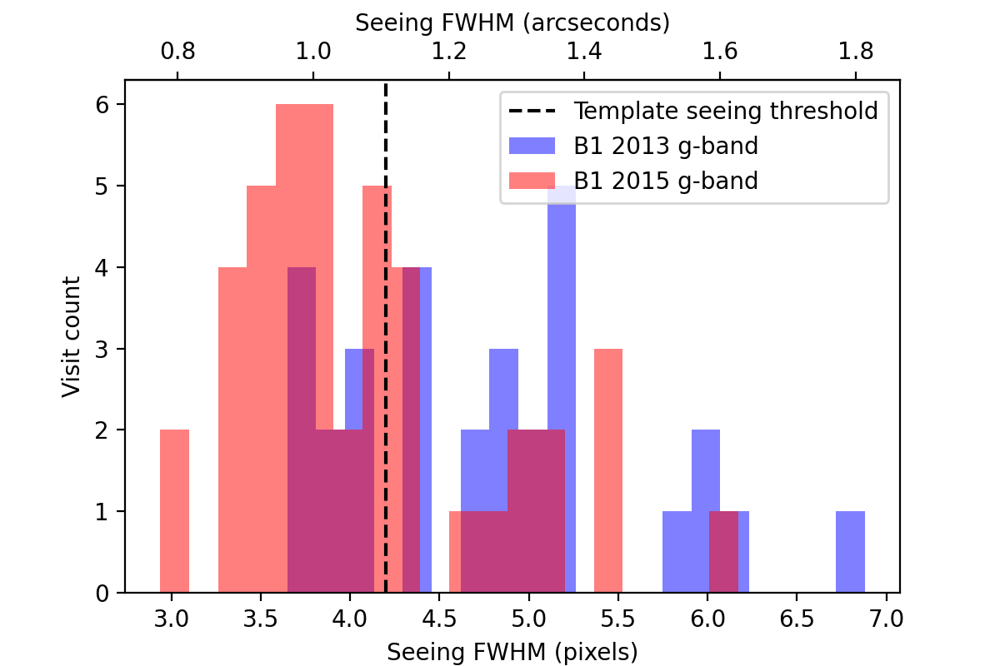

In [74]:
fig, ax = plt.subplots(figsize=(6, 4))
plt.hist(psf_size_B1_2013_g_dict.values(), 20, alpha=0.5, color='b')
plt.hist(psf_size_B1_2015_g_dict.values(), 20, alpha=0.5, color='r')
plt.xlabel('Seeing FWHM (pixels)')
plt.ylabel('Visit count')
secax = ax.secondary_xaxis('top', functions=(lambda x: x*pixelScale, lambda x: x/pixelScale))
secax.set_xlabel('Seeing FWHM (arcseconds)')
plt.axvline(x=4.2, color='k', linestyle="--")
plt.legend(["Template seeing threshold", "B1 2013 g-band", "B1 2015 g-band"])

<IPython.core.display.Javascript object>


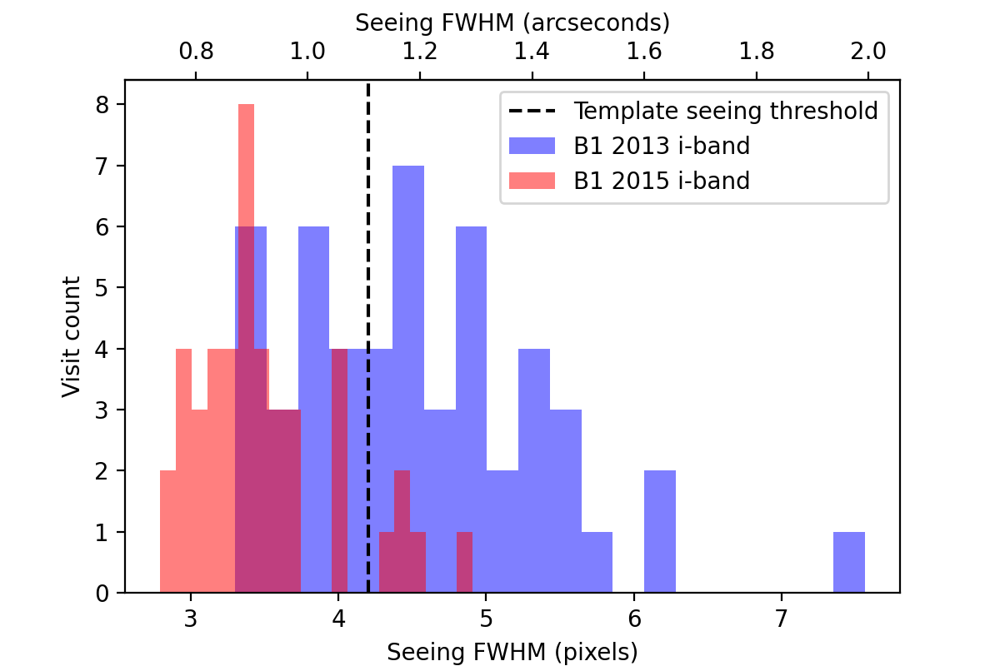

In [75]:
fig, ax = plt.subplots(figsize=(6, 4))
plt.hist(psf_size_B1_2013_i_dict.values(), 20, alpha=0.5, color='b')
plt.hist(psf_size_B1_2015_i_dict.values(), 20, alpha=0.5, color='r')
plt.xlabel('Seeing FWHM (pixels)')
plt.ylabel('Visit count')
secax = ax.secondary_xaxis('top', functions=(lambda x: x*pixelScale, lambda x: x/pixelScale))
secax.set_xlabel('Seeing FWHM (arcseconds)')
plt.axvline(x=4.2, color='k', linestyle="--")
plt.legend(["Template seeing threshold", "B1 2013 i-band", "B1 2015 i-band"])

<IPython.core.display.Javascript object>


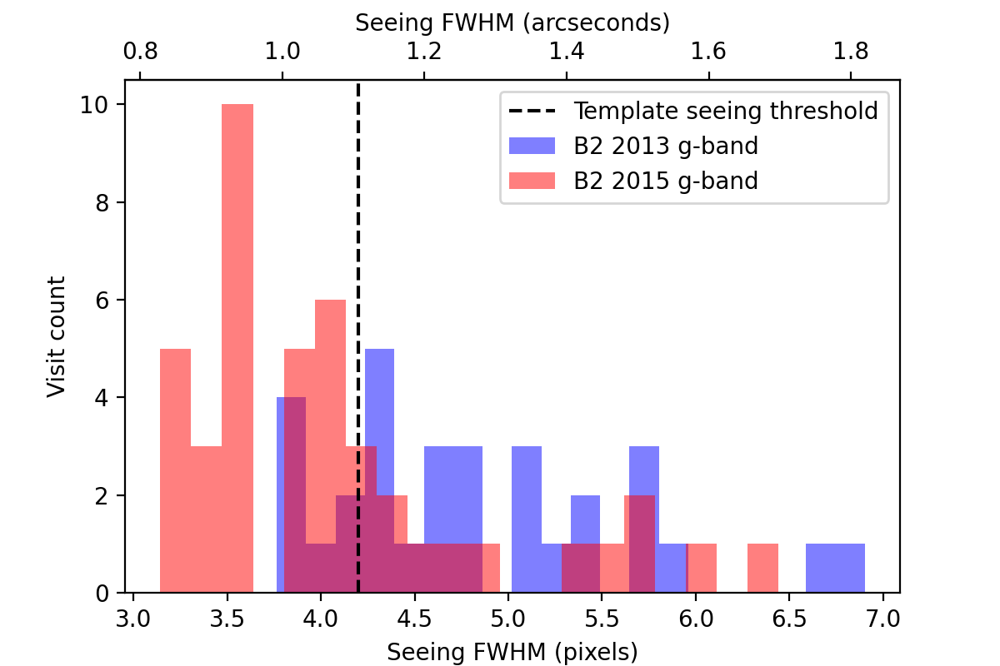

In [76]:
fig, ax = plt.subplots(figsize=(6, 4))
plt.hist(psf_size_B2_2013_g_dict.values(), 20, alpha=0.5, color='b')
plt.hist(psf_size_B2_2015_g_dict.values(), 20, alpha=0.5, color='r')
plt.xlabel('Seeing FWHM (pixels)')
plt.ylabel('Visit count')
secax = ax.secondary_xaxis('top', functions=(lambda x: x*pixelScale, lambda x: x/pixelScale))
secax.set_xlabel('Seeing FWHM (arcseconds)')
plt.axvline(x=4.2, color='k', linestyle="--")
plt.legend(["Template seeing threshold", "B2 2013 g-band", "B2 2015 g-band"])

<IPython.core.display.Javascript object>


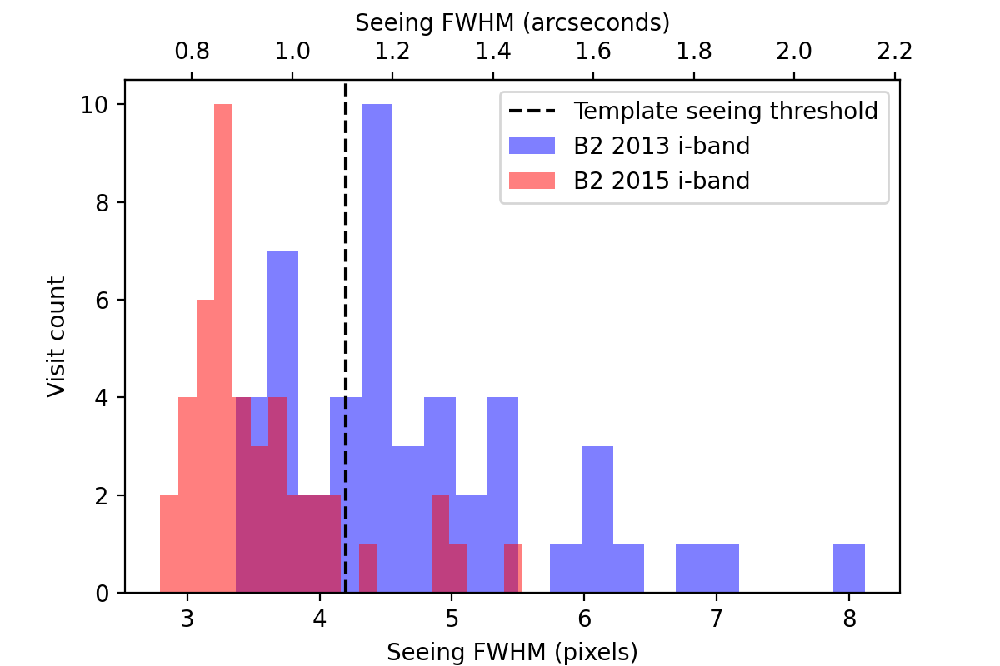

In [77]:
fig, ax = plt.subplots(figsize=(6, 4))
plt.hist(psf_size_B2_2013_i_dict.values(), 20, alpha=0.5, color='b')
plt.hist(psf_size_B2_2015_i_dict.values(), 20, alpha=0.5, color='r')
plt.xlabel('Seeing FWHM (pixels)')
plt.ylabel('Visit count')
secax = ax.secondary_xaxis('top', functions=(lambda x: x*pixelScale, lambda x: x/pixelScale))
secax.set_xlabel('Seeing FWHM (arcseconds)')
plt.axvline(x=4.2, color='k', linestyle="--")
plt.legend(["Template seeing threshold", "B2 2013 i-band", "B2 2015 i-band"])

# Estimate the amount of time it took to run Single Frame Measurement
Including:
* Instrument Signature Removal
* calibration
* PSF measurement 
* cosmic ray detection and repair
* source measurement and deblending
* source matching to a reference catalog
* astrometric calibration
* photometric calibration

The durations were calculated *really* simply: I ran `ls -g 0*/calexp/* > calexp_list.txt` in processed_data, then imported the output in Numbers, sanitized it, calculated the time stamp difference of sequential ccds, and calculated a histogram of those differences. ccd=1 was dropped every time, because I could not easily determine the previously written file. The histogram values are copied here.

In [78]:
duration_counts=[2821,7239,4579,2028,942,662,418,267,201,139,112,91,66,88,94,64,55,44,48,38,35,37,49,38,21,29,12,23,22,18,12,1,11,5,4,4,5,4,1,3,1,1,2,0,0,0,3,1,0,2,0,0,0,0,0,0,0,0,0,1]

In [79]:
durations=np.arange(1,61)

<IPython.core.display.Javascript object>


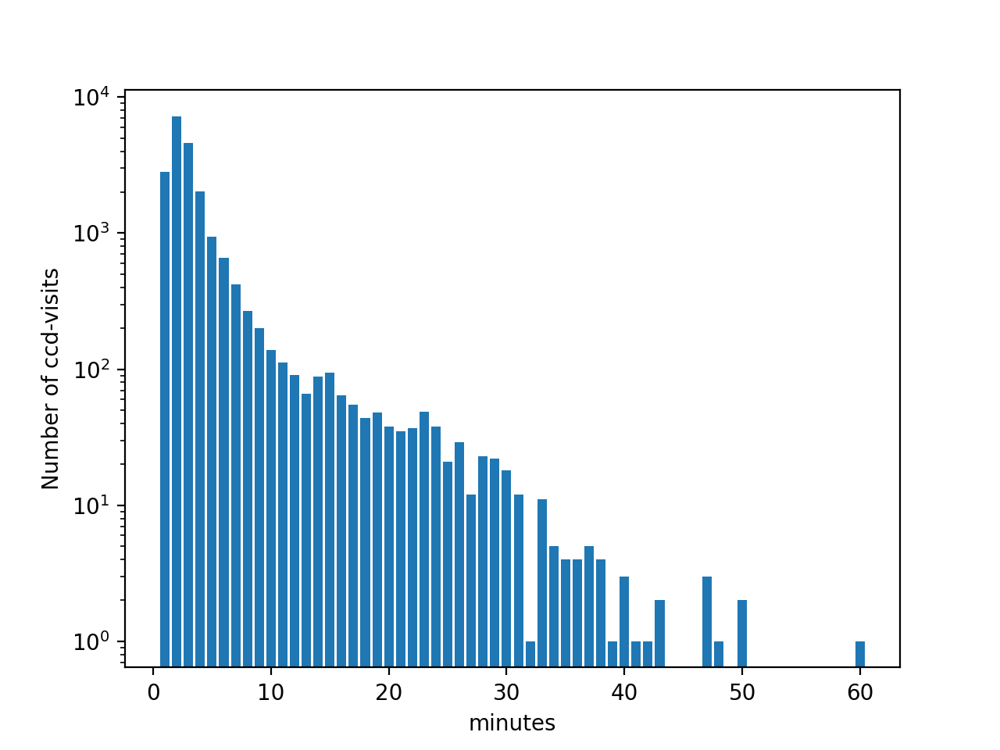

In [80]:
fig, ax = plt.subplots()
ax.bar(durations[0:60], height=duration_counts[0:60])
ax.set_yscale('log')
ax.set_xlabel('minutes')
ax.set_ylabel('Number of ccd-visits')
fig.show()

New run with hopefully better astrometry

In [81]:
duration_counts_2013 = [696,2855,2274,1203,702,459,327,245,178,137,101,60,58,50,35,41,34,39,27,38,20,29,27,21,24,13,20,12,11,12,7,6,5,2,1,2,4,3,1,2,1,0,4,1,2,0,0,1]

<IPython.core.display.Javascript object>


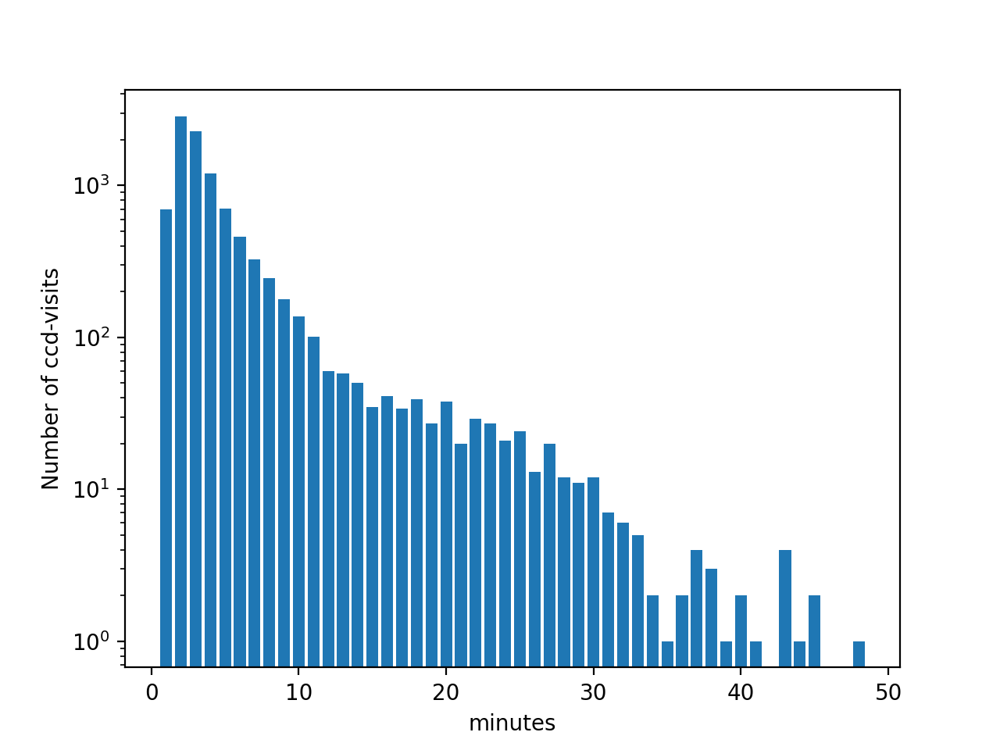

In [82]:
fig, ax = plt.subplots()
ax.bar(durations[0:len(duration_counts_2013)], height=duration_counts_2013)
ax.set_yscale('log')
ax.set_xlabel('minutes')
ax.set_ylabel('Number of ccd-visits')
fig.show()

In [83]:
duration_counts_2015 = [1195,3563,2954,1033,578,382,222,127,70,51,34,42,27,33,39,40,20,15,13,9,11,11,6,6,12,15,13,6,4,4,3,2,4,2,0,1,4,1,0,0,0,0,0,1,0,0,0,1,0,0]

<IPython.core.display.Javascript object>


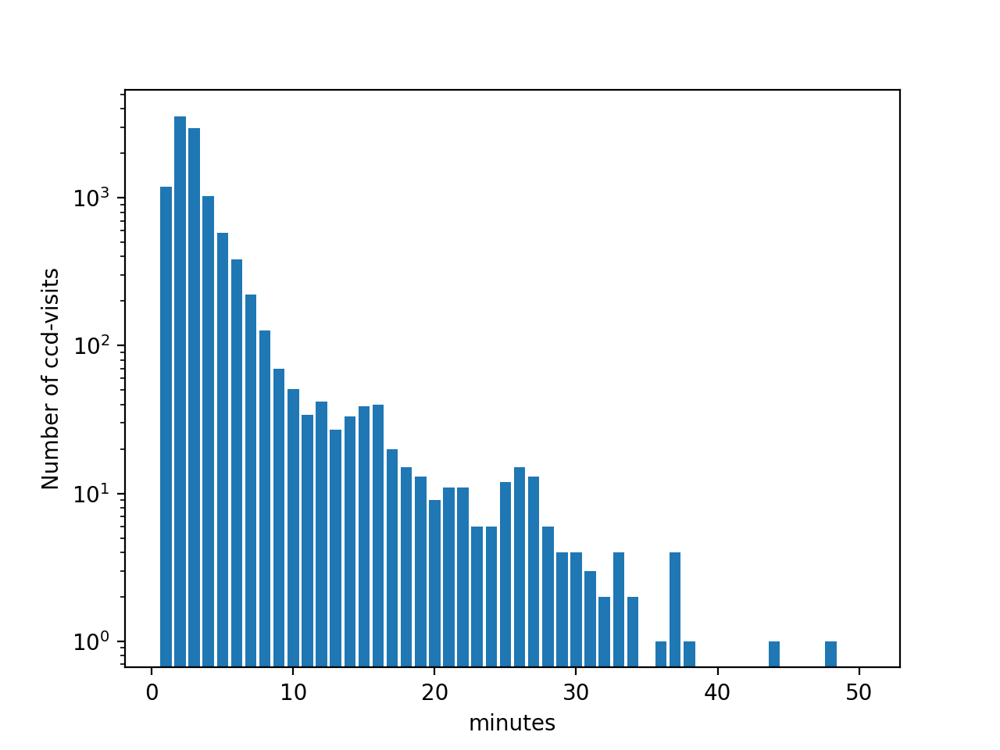

In [100]:
fig, ax = plt.subplots()
ax.bar(durations[0:len(duration_counts_2015)], height=duration_counts_2015)
ax.set_yscale('log')
ax.set_xlabel('minutes')
ax.set_ylabel('Number of ccd-visits')
fig.show()

# Look at the PSFs of each of the visits

In [85]:
from astropy.visualization import (ZScaleInterval, SqrtStretch, ImageNormalize, AsinhStretch)

In [86]:
psf_test = psf_B1_2015_g_dict[427318].computeImage().getArray()

In [87]:
len(psf_B1_2015_g_dict)

44

In [88]:
def plot_visit_psfs(psf_dict, norm=None):
    nx = np.ceil(np.sqrt(len(psf_dict)))
    ny = np.ceil(len(psf_dict)/nx)
    fig, ax = plt.subplots(nx, ny, figsize=(6, 4))
    norm = ImageNormalize(psf_test, interval=ZScaleInterval(), stretch=AsinhStretch())
    im = plt.imshow(psf_test, norm=norm)

<IPython.core.display.Javascript object>


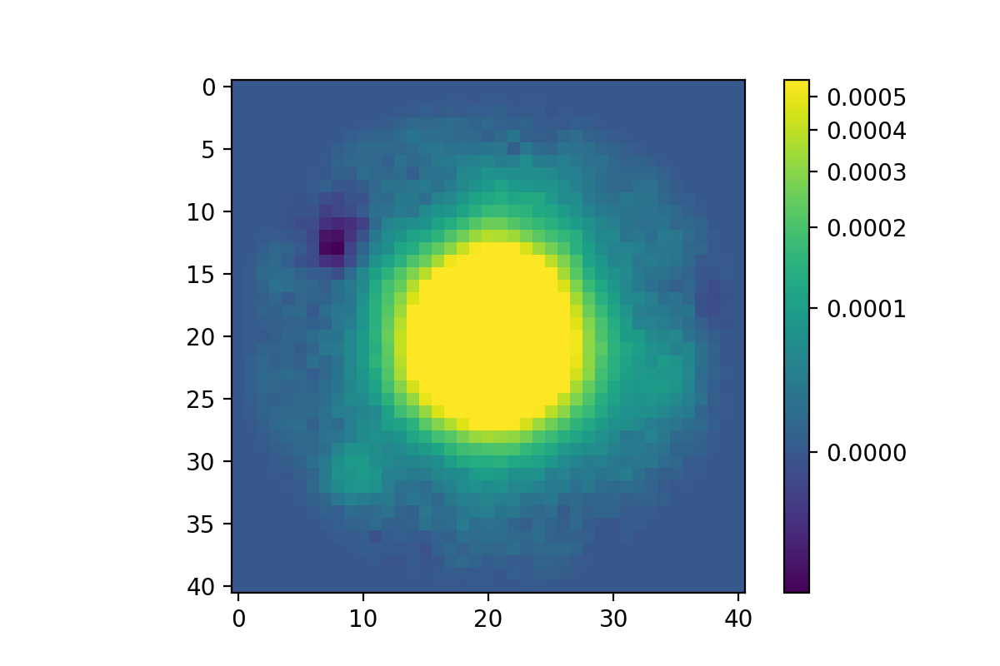

In [89]:
fig, ax = plt.subplots(figsize=(6, 4))
norm = ImageNormalize(psf_test, interval=ZScaleInterval(), stretch=AsinhStretch())
im = plt.imshow(psf_test, norm=norm)
fig.colorbar(im)

In [90]:
norm = ImageNormalize(psf_B1_2015_g_dict[427318].computeImage().getArray(), interval=ZScaleInterval(), stretch=SqrtStretch())

In [91]:
levels = [.06/(5**i) for i in range(6,-1,-1)]

In [92]:
def plot_visit_psfs(psf_dict, fig=None, norm=None, filename=None, title=None, show_colorbar=True, levels=None):
    
    nx = int(np.ceil(np.sqrt(len(psf_dict))))
    ny = int(np.ceil(len(psf_dict)/nx))
    if fig is None:
        fig = plt.figure(figsize=(2*nx, 2*ny))
    gs1 = gridspec.GridSpec(ny, nx)
    gs1.update(wspace=0.0, hspace=0.0)  # set the spacing between axes.
    
    i = 0
    for visit, psf in psf_dict.items():
        ax = plt.subplot(gs1[i])
        x = i % nx
        psf_array = psf.computeImage().getArray()
        psf_array /= np.sum(psf_array)
        if norm is None:
            norm = ImageNormalize(psf_array, interval=ZScaleInterval(), stretch=SqrtStretch())
        im = ax.imshow(psf_array, norm=norm)
        if levels is None:
            levels = [np.max(psf_array)/(5**i) for i in range(6,-1,-1)]
    
        contour = ax.contour(psf_array, levels)
        ax.text(4, 4, visit, color='r')
        plt.setp(ax, xticks=[], yticks=[])
        i += 1
    psf_array *= 0
    for x2 in range(x + 1, nx):    
        ax = plt.subplot(gs1[i])
        im = ax.imshow(psf_array, norm=norm)
        plt.setp(ax, xticks=[], yticks=[])
        i += 1
    plt.subplots_adjust(wspace=0)

    if title:
        fig.suptitle(title, fontsize=18, y=.95)
    if show_colorbar:
        formatter_im = LogFormatter(2, labelOnlyBase=False)
        cbar_im_width = 0.01
        cbar_im_height = 0.5
        cbar_im_ax = fig.add_axes([0.9, 0.5 - cbar_im_height/2, cbar_im_width, cbar_im_height])
        cbar_im = fig.colorbar(im, cax=cbar_im_ax, format='%.2e', extend='both')
        cbar_im.set_label('PSF values')
        
        formatter_cn = LogFormatter(5, labelOnlyBase=False, minor_thresholds=(len(levels),.4))
        cbar_cn_width = 0.2
        cbar_cn_height = 0.01
        cbar_cn_ax = fig.add_axes([0.5 - cbar_cn_width/2, 0.1, cbar_cn_width, cbar_cn_height])
        
        cbar_cn = fig.colorbar(contour, cax=cbar_cn_ax, format=formatter_cn, orientation="horizontal")
#         cbar_im.set_ticks([])
        cbar_cn.set_label('Contour values')
    if filename:
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")

<IPython.core.display.Javascript object>


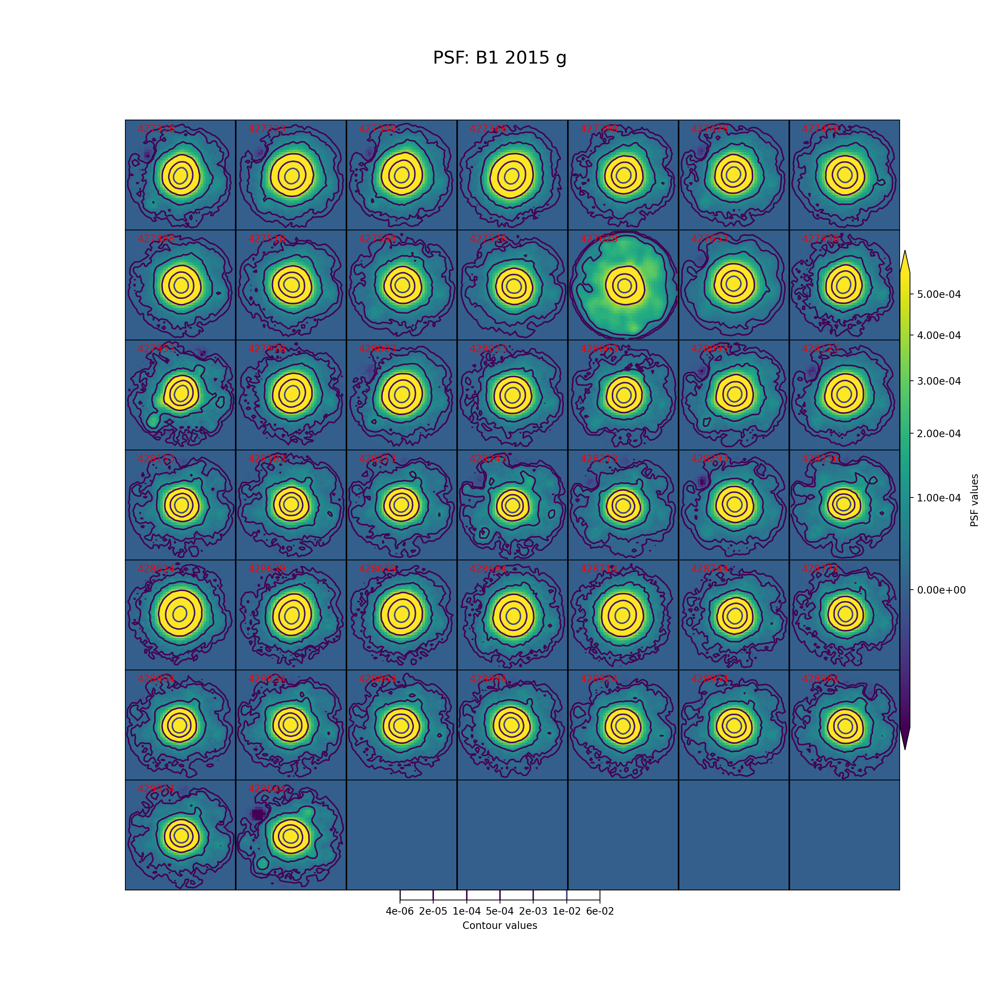

In [93]:
plot_visit_psfs(psf_B1_2015_g_dict, norm=norm, title="PSF: B1 2015 g", levels=levels)

In [94]:
field="B1"
year="2015"
band="g"

In [95]:
psf_lookup = {"2015":{"g":{"B1":psf_B1_2015_g_dict,
                           "B2":psf_B2_2015_g_dict},
                      "i":{"B1":psf_B1_2015_i_dict,
                           "B2":psf_B2_2015_i_dict}
                     },
              "2013":{"g":{"B1":psf_B1_2013_g_dict,
                           "B2":psf_B2_2013_g_dict},
                      "i":{"B1":psf_B1_2013_i_dict,
                           "B2":psf_B2_2013_i_dict}
                     }}

<IPython.core.display.Javascript object>


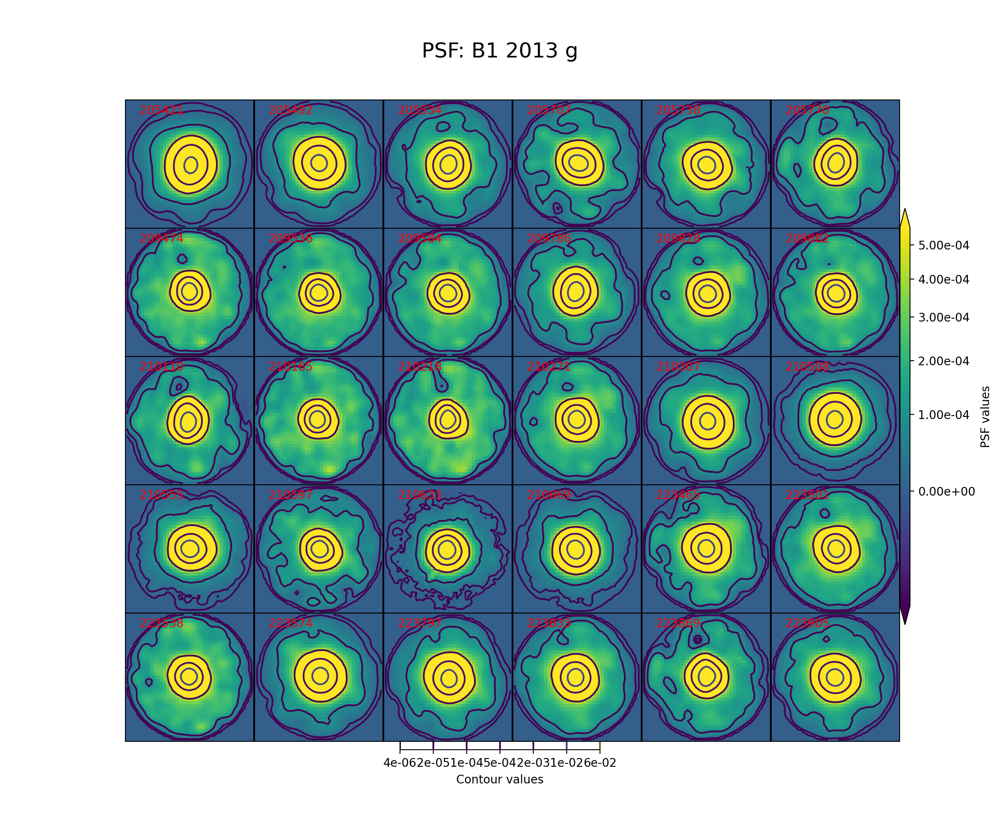

<IPython.core.display.Javascript object>


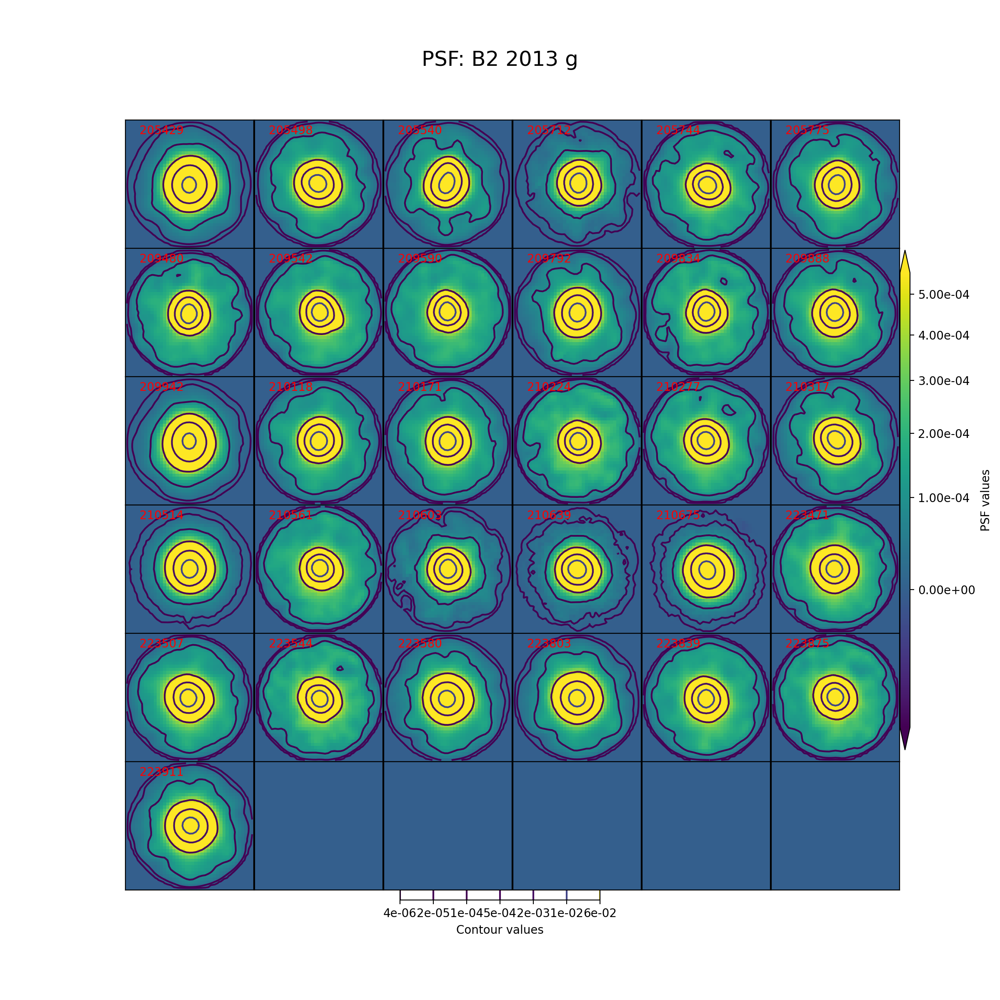

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


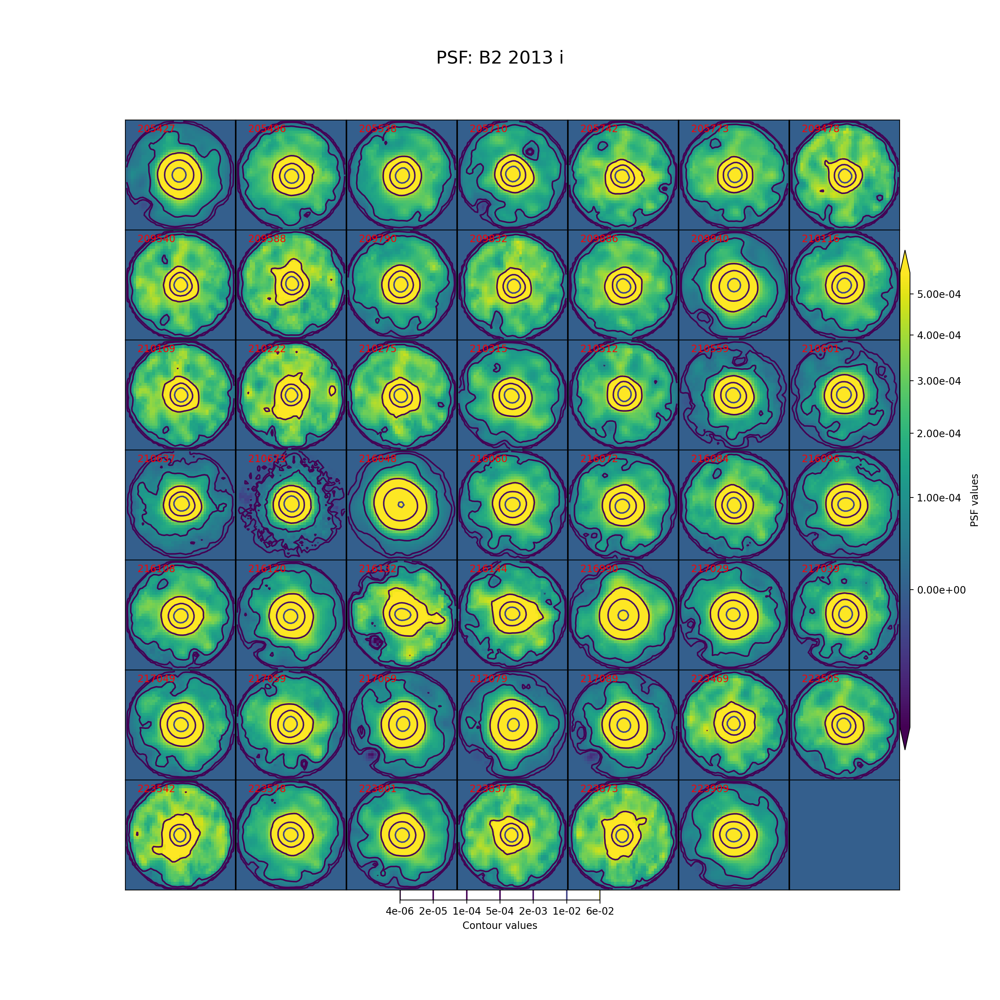

<IPython.core.display.Javascript object>


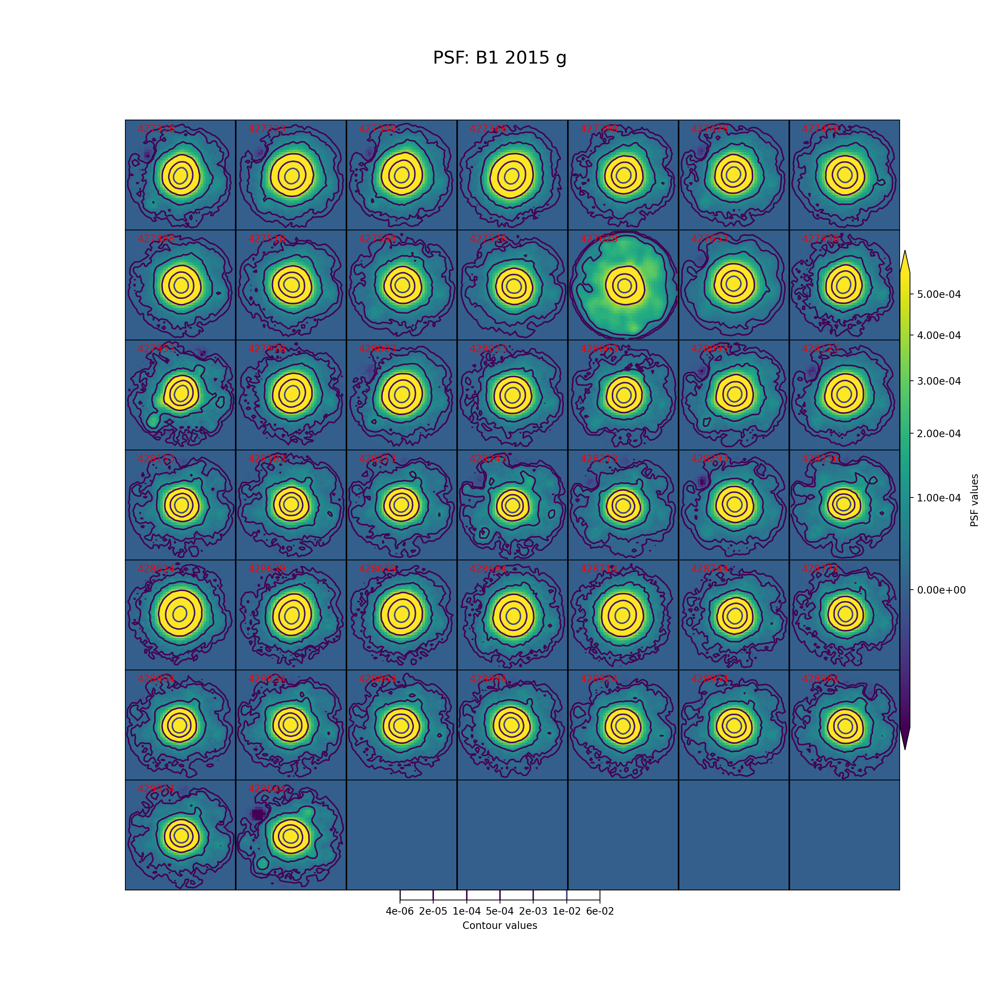

<IPython.core.display.Javascript object>


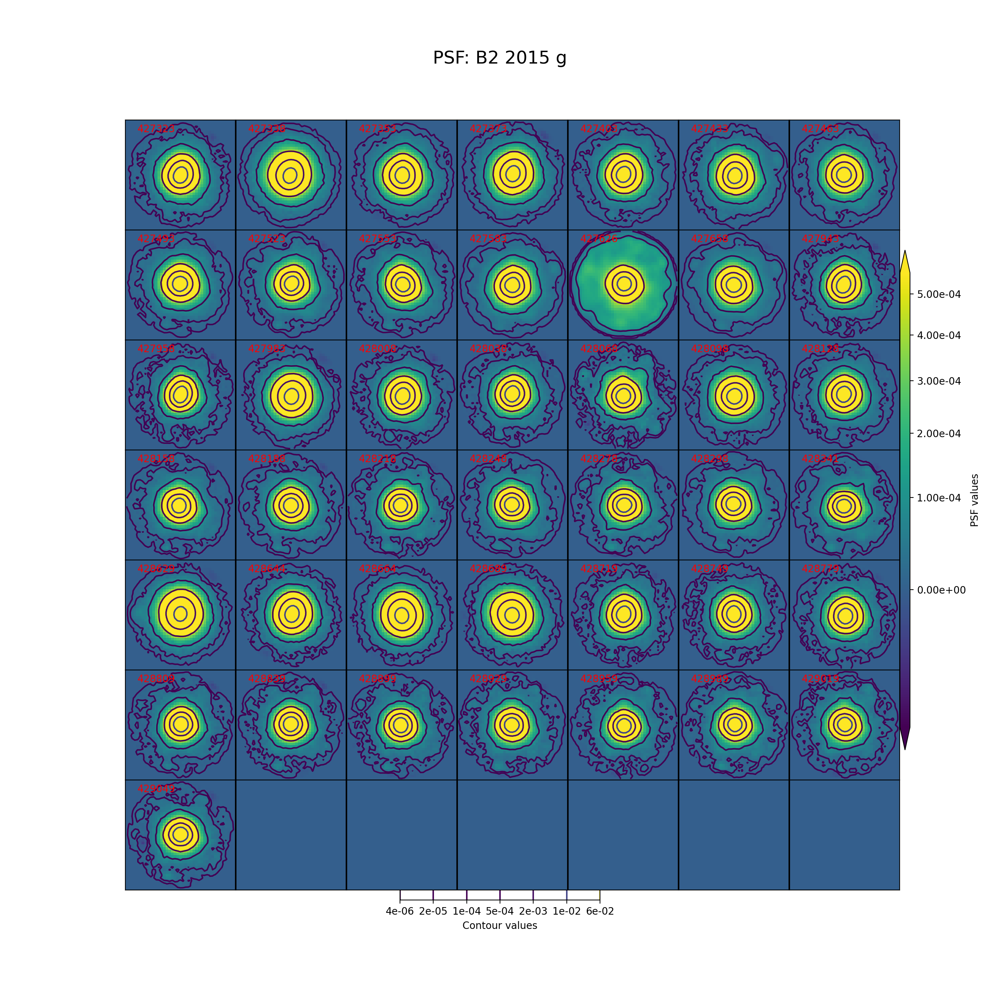

<IPython.core.display.Javascript object>


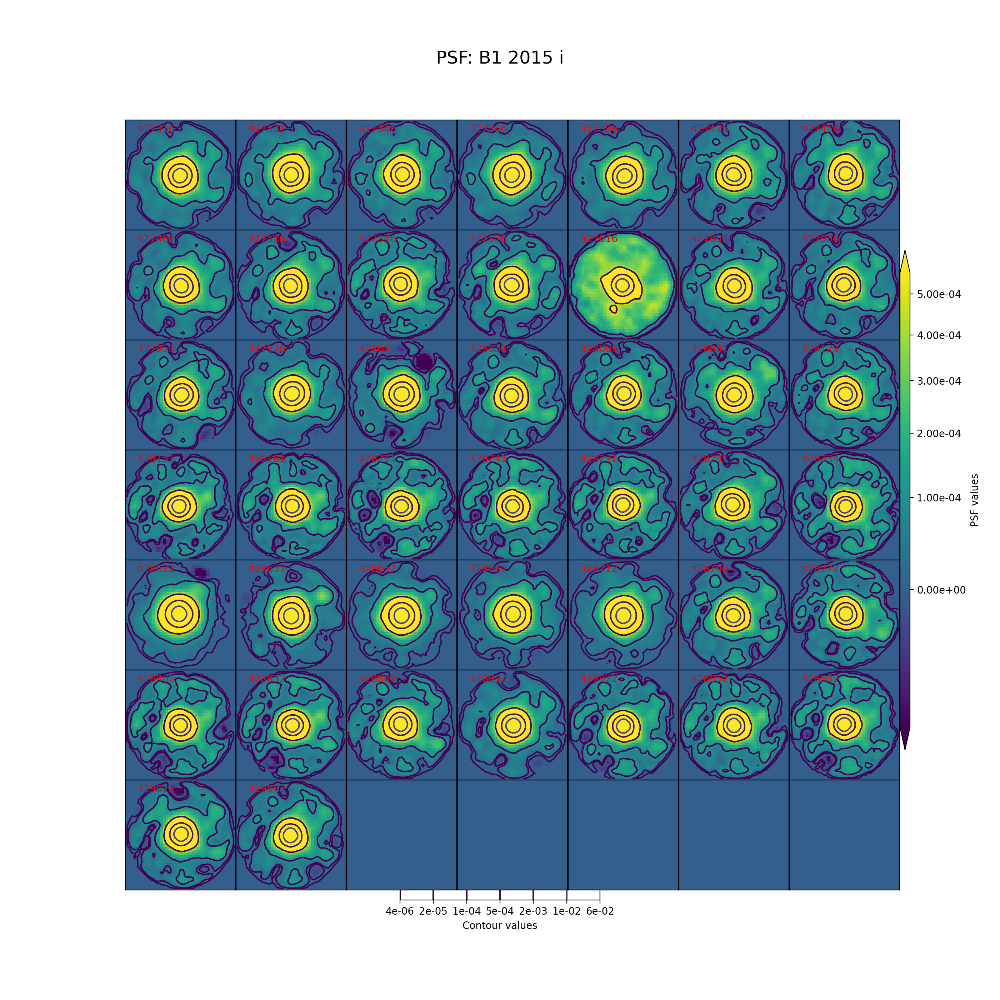

<IPython.core.display.Javascript object>


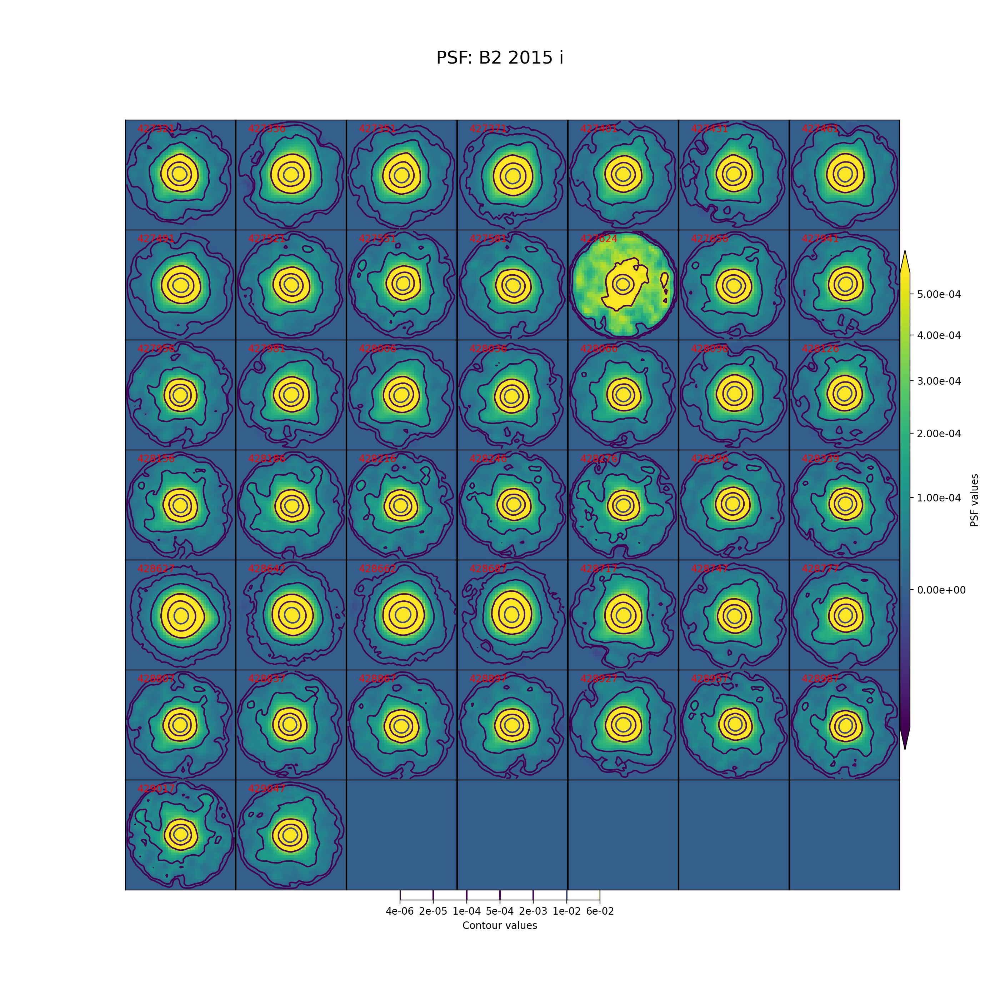

In [96]:
for year in ["2013", "2015"]:
    for band in ["g", "i"]:
        for field in ["B1", "B2"]:
            plot_visit_psfs(psf_lookup[year][band][field], title=f"PSF: {field} {year} {band}", filename=f"psf_{field}_{year}_{band}.png", norm=norm, levels=levels)

# Templates and image differences

Pick a ccd to look at the science images, and load the warped templates that were used for image differencing. Also load and inspect the residuals.

In [99]:
ccd_use = 42

In [101]:
psf_size_B1_2013_g_dict

{205421: 6.879623493685429,
 205492: 6.08923278317827,
 205534: 5.231992516178543,
 205707: 5.091101440773185,
 205738: 4.932567900063948,
 205770: 5.001890193177576,
 209474: 3.74664718691394,
 209536: 3.855506254443124,
 209584: 4.0480837604842534,
 209786: 5.186187073794974,
 209828: 4.424062691521925,
 209882: 4.107071974291277,
 210110: 4.889905139890876,
 210165: 3.691678180682114,
 210218: 3.7941945621352784,
 210271: 4.299735334156401,
 210307: 6.042633559170309,
 210508: 5.9382248873383014,
 210555: 4.348650729833699,
 210597: 3.648524921814897,
 210633: 4.129801627241028,
 210669: 5.153923681217653,
 223465: 4.684509698363347,
 223501: 4.365189762019807,
 223538: 3.864732082973737,
 223574: 5.79425303600872,
 223797: 5.190122173651266,
 223833: 4.682938564627641,
 223869: 4.886193906262226,
 223905: 5.166079145385671}

In [102]:
psf_size_B2_2013_g_dict

{205429: 6.743263102407585,
 205498: 5.079404864665152,
 205540: 5.755258405132327,
 205712: 4.644966946414147,
 205744: 4.356488796717153,
 205775: 5.066566030802273,
 209480: 4.535329727055186,
 209542: 4.239047092596211,
 209590: 4.03665901574272,
 209792: 5.2863177208097,
 209834: 4.269029687569974,
 209888: 4.738108233472436,
 209942: 6.902175689502052,
 210118: 4.748758327386482,
 210171: 4.850657303093984,
 210224: 3.8927449490344816,
 210277: 4.387774367802352,
 210317: 5.05451303114551,
 210514: 5.677273872015376,
 210561: 3.764070461762644,
 210603: 4.106024227484092,
 210639: 4.61970037889557,
 210675: 5.855358272732459,
 223471: 4.282359368648912,
 223507: 4.703902525008415,
 223544: 3.798559944178932,
 223580: 5.400848860939001,
 223803: 5.482995955054472,
 223839: 4.205015951048877,
 223875: 3.8841791354801667,
 223911: 5.663521828843992}

In [103]:
psf_size_B1_2013_i_dict

{205419: 6.135785048448293,
 205490: 4.980413701192553,
 205532: 4.891833541928688,
 205705: 4.507430501231307,
 205736: 4.188218053940055,
 205768: 4.214616504982037,
 209472: 3.351450323690044,
 209534: 3.4786608206866454,
 209582: 3.300476848217934,
 209784: 4.562382185829775,
 209826: 3.979542673340148,
 209880: 3.8564668255506294,
 210108: 4.494077782271987,
 210112: 3.7569253120689488,
 210163: 3.705380525533273,
 210216: 3.5055838317976056,
 210269: 3.9013789851431486,
 210305: 4.095856051234297,
 210506: 4.586209955983666,
 210553: 3.4029130485327737,
 210595: 3.4653166439503833,
 210631: 3.7647810440852876,
 210667: 4.571221412573046,
 216042: 5.058990364753168,
 216043: 5.425836383575163,
 216044: 5.173728102325971,
 216045: 5.424726052280889,
 216046: 5.507824496129089,
 216058: 4.98770580818632,
 216070: 5.000413540801324,
 216082: 3.9601567528207178,
 216094: 4.727618279013911,
 216106: 4.540029359165852,
 216118: 4.548793193401764,
 216130: 4.402848770798511,
 216142: 4.8

In [104]:
psf_size_B2_2013_i_dict

{205427: 5.938962990851775,
 205496: 4.3737967988442685,
 205538: 4.752096882753617,
 205710: 4.34549612495318,
 205742: 3.7706071100762606,
 205773: 4.331517213793707,
 209478: 3.5993531131903125,
 209540: 3.8637456689903553,
 209588: 3.6145802107140987,
 209790: 4.622527802142754,
 209832: 3.716061115812753,
 209886: 4.080109046014963,
 209940: 6.412521038010686,
 210116: 4.495476807694671,
 210169: 3.7351357266269885,
 210222: 3.4422909280573926,
 210275: 3.802471830598286,
 210315: 4.778930533569386,
 210512: 3.9382194329948774,
 210559: 4.17006355250532,
 210601: 4.366223223654629,
 210637: 4.143107790162596,
 210673: 4.346221426803933,
 216048: 8.119273800044136,
 216060: 5.031258073709126,
 216072: 4.851979965087879,
 216084: 4.474032762015427,
 216096: 5.325451110242126,
 216108: 4.503883451340657,
 216120: 5.366836827569106,
 216132: 4.880186027517513,
 216144: 4.468417728279319,
 216990: 7.0513673647613055,
 217029: 5.985767778251058,
 217039: 5.126289085897736,
 217049: 5.41

In [172]:
sci_visits_g_2013a = [223465, 209888]
sci_visits_i_2013a = [216070, 217057]
sci_visits_g_2013 = [210271, 209834]
sci_visits_i_2013 = [210108, 216144]

In [131]:
repo_figs = '/project/sullivan/saha2/ap_pipe_figs/'
butler_figs = dafPersist.Butler(repo_figs)

In [176]:
template = butler_figs.get("deepDiff_differenceExp", dataId={"visit":209834, "ccdnum":ccd_use})

In [205]:
def plot_calexp_template_diff(butler, visit, ccd, fig=None, norm=None, filename_base=None, title=None, show_colorbar=False):
    names = ["calexp", "deepDiff_warpedExp", "deepDiff_differenceExp"]
    if fig is None:
        fig = plt.figure(figsize=(6, 12))
    ax = plt.subplot()
    dataId = {"visit":visit, "ccdnum":ccd}
    science = butler.get("calexp", dataId=dataId).image.array
    template = butler.get("deepDiff_warpedExp", dataId=dataId).image.array
    diff = butler.get("deepDiff_differenceExp", dataId=dataId).image.array
    rescale = np.median(np.abs(template))/np.median(np.abs(science))
    print(rescale)

    if norm is None:
        norm = ImageNormalize(template, interval=ZScaleInterval(), stretch=AsinhStretch())
    im_s = ax.imshow(science*rescale, norm=norm)
    
    if title:
        fig.suptitle(title + ' calexp', fontsize=18, y=.95)
    if filename_base:
        filename = filename_base + '_calexp.png'
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")

    im_t = ax.imshow(template, norm=norm)
    if title:
        fig.suptitle(title + ' template', fontsize=18, y=.95)  
    if filename_base:
        filename = filename_base + '_template.png'
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")

    im_d = ax.imshow(diff, norm=norm)
    if title:
        fig.suptitle(title + ' diffim', fontsize=18, y=.95)
    if filename_base:
        filename = filename_base + '_diff.png'
        try:
            plt.savefig(filename, transparent=True)
        except Exception as e:
            print(f"Could not write file '{filename}': {e}")    
    
#     if title:
#         fig.suptitle(title, fontsize=18, y=.95)
#     if show_colorbar:
#         formatter_im = LogFormatter(2, labelOnlyBase=False)
#         cbar_im_width = 0.01
#         cbar_im_height = 0.5
#         cbar_im_ax = fig.add_axes([0.9, 0.5 - cbar_im_height/2, cbar_im_width, cbar_im_height])
#         cbar_im = fig.colorbar(im, cax=cbar_im_ax, format='%.1e', extend='both')
#         cbar_im.set_label('Pixel values (nJy)')

<IPython.core.display.Javascript object>


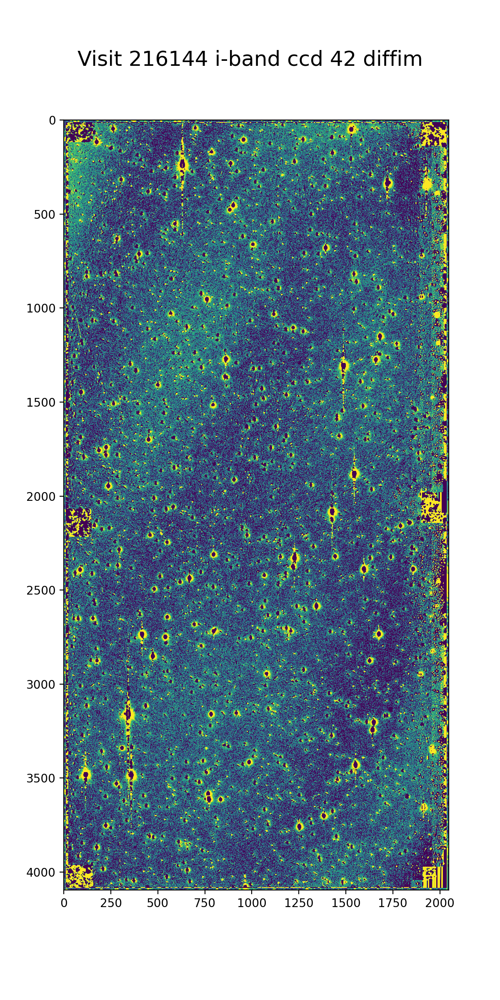

0.04671491


In [206]:
visit = sci_visits_i_2013[1]
band = 'i'
plot_calexp_template_diff(butler_figs, visit, ccd_use, title=f"Visit {visit} {band}-band ccd {ccd_use}", filename_base=f"Compare2_{visit}_{band}_{ccd_use}")

<IPython.core.display.Javascript object>


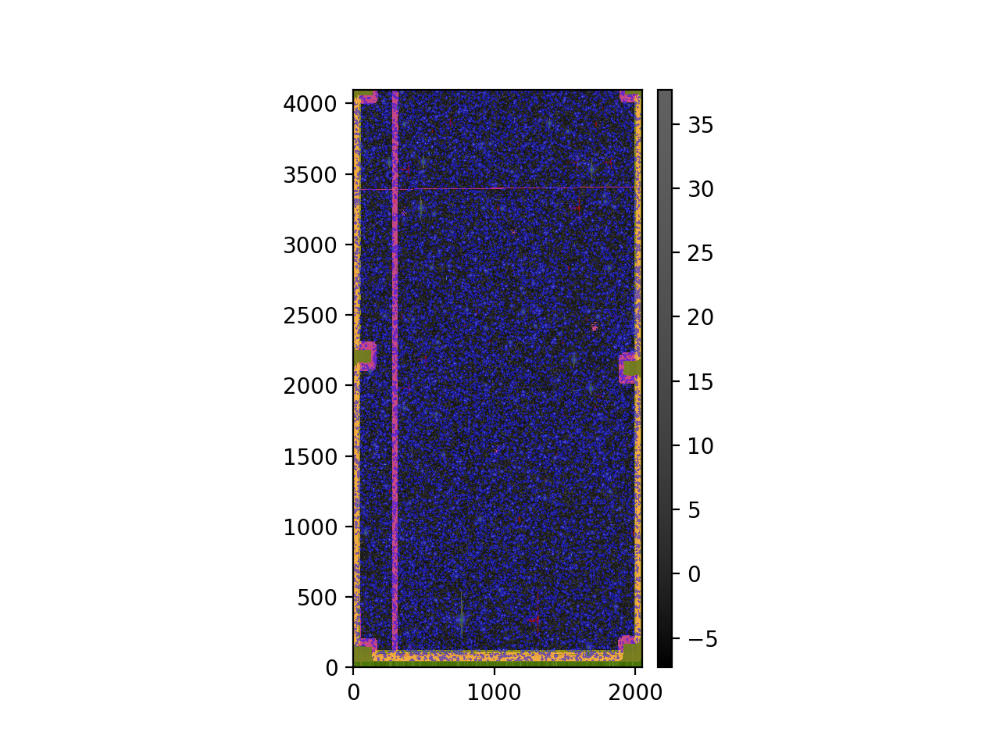

In [130]:
disp1 = afwDisplay.Display()
disp1.setMaskTransparency(50)
disp1.scale('asinh', 'zscale', Q=8)
disp1.mtv(template)

In [207]:
1+1

2